<a href="https://colab.research.google.com/github/abhikrant11dhepe/clear_view/blob/main/ResNet_Classification_BTP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ResNet-50 for Classification of Haze and Fog

In [ ]:
# Importing the required libraries

# display, transform, read, split ...
import numpy as np
import cv2 as cv
import os
import splitfolders
import matplotlib.pyplot as plt

# tensorflow
import tensorflow.keras as keras
import tensorflow as tf

# image processing
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img

# model / neural network
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input



### Visualize dataset images

The first step is to display an image of each class to see what it looks like.

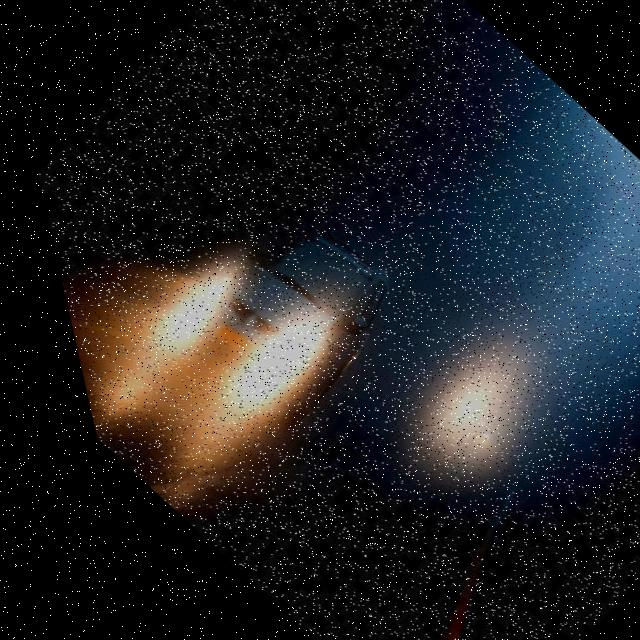

In [ ]:
# Fog
img_fog = image.load_img("BTP_Dataset/train/fog/1_jpg.rf.0be0bf61ae1ce839d5a49a2137f15135.jpg")
img_fog

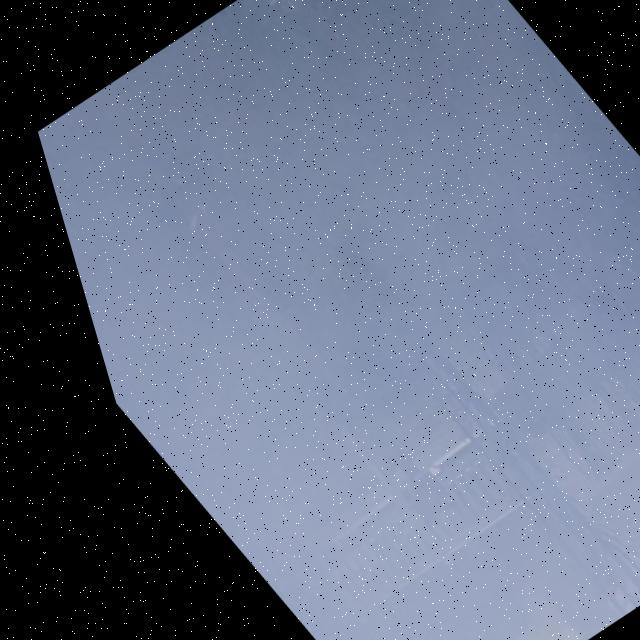

In [ ]:
# Haze
img_haze = image.load_img("BTP_Dataset/train/haze/01_hazy_png_jpg.rf.5e57f3ad824dd0fefbaa6b6f1dd382c8.jpg")
img_haze

### Create Keras data generators

In [ ]:
datagen = ImageDataGenerator()

In [ ]:
# define classes name
class_names = ['fog','haze']

In [ ]:
# training data
train_generator = datagen.flow_from_directory(
    directory="./BTP_Dataset/train",
    classes = class_names,
    target_size=(224, 224),
    batch_size=32,
    class_mode="binary",
)

Found 3025 images belonging to 2 classes.


In [ ]:
# validation data
valid_generator = datagen.flow_from_directory(
    directory="./BTP_Dataset/valid",
    classes = class_names,
    target_size=(224, 224),
    batch_size=32,
    class_mode="binary",
)

Found 102 images belonging to 2 classes.


In [ ]:
# test data
test_generator = datagen.flow_from_directory(
    directory="./BTP_Dataset/test",
    classes = class_names,
    target_size=(224, 224),
    batch_size=32,
    class_mode="binary",
)

Found 61 images belonging to 2 classes.


###  Build the model

The first step is to build the model, using **ResNet50**.

In [ ]:
# ResNet50 model
resnet_50 = ResNet50(include_top=False, weights='imagenet', input_shape=(224,224,3))
for layer in resnet_50.layers:
    layer.trainable = False

In [ ]:
# build the entire model
x = resnet_50.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(256, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(64, activation='relu')(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(5, activation='softmax')(x)
model = Model(inputs = resnet_50.input, outputs = predictions)

### Train the model

**Adam** optimizer is used to train the model over **10 epochs**. It is enough by using Transfer Learning.

The loss is calculated with the **sparse_categorical_crossentropy** function.

In [ ]:
# define training function
def trainModel(model, epochs, optimizer):
    batch_size = 32
    model.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])
    return model.fit(train_generator, validation_data=valid_generator, epochs=epochs, batch_size=batch_size)

In [ ]:
# launch the training
model_history = trainModel(model = model, epochs = 10, optimizer = "Adam")
print("The model has been trained")
model.save('fog_haze.h5')
print("Saving the model as fog_haze.h5")

Epoch 1/10
95/95 [==============================] - 95s 972ms/step - loss: 0.6946 - accuracy: 0.7798 - val_loss: 0.0472 - val_accuracy: 0.9902
Epoch 2/10
95/95 [==============================] - 90s 950ms/step - loss: 0.0675 - accuracy: 0.9785 - val_loss: 0.0060 - val_accuracy: 1.0000
Epoch 3/10
95/95 [==============================] - 90s 951ms/step - loss: 0.0330 - accuracy: 0.9914 - val_loss: 4.7964e-04 - val_accuracy: 1.0000
Epoch 4/10
95/95 [==============================] - 91s 953ms/step - loss: 0.0331 - accuracy: 0.9898 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 5/10
95/95 [==============================] - 89s 939ms/step - loss: 0.0211 - accuracy: 0.9944 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 6/10
95/95 [==============================] - 91s 953ms/step - loss: 0.0154 - accuracy: 0.9967 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 7/10
95/95 [==============================] - 90s 951ms/step - loss: 0.0147 - accuracy: 0.9964 - val_loss: 0.0142 - val_accuracy: 0.

c:\Users\Abhikrant Rajesh\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Saving the model as fog_haze.h5


### Display Loss Curves:

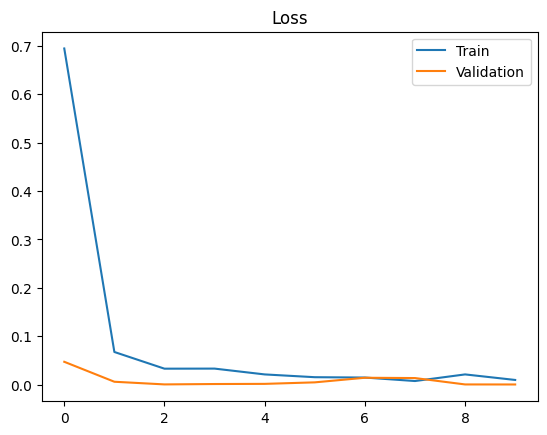

In [ ]:
loss_train_curve = model_history.history["loss"]
loss_val_curve = model_history.history["val_loss"]
plt.plot(loss_train_curve, label = "Train")
plt.plot(loss_val_curve, label = "Validation")
plt.legend(loc = 'upper right')
plt.title("Loss")
plt.show()

- Display **accuracy** curves:

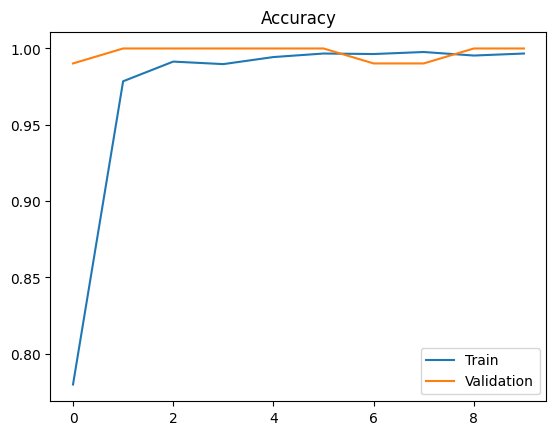

In [ ]:
acc_train_curve = model_history.history["accuracy"]
acc_val_curve = model_history.history["val_accuracy"]
plt.plot(acc_train_curve, label = "Train")
plt.plot(acc_val_curve, label = "Validation")
plt.legend(loc = 'lower right')
plt.title("Accuracy")
plt.show()

### Evaluate the model

The model is evaluated on test data.

In [ ]:
test_loss, test_acc = model.evaluate(test_generator)
print("The test loss is: ", test_loss)
print("The best accuracy is: ", test_acc*100)

2/2 [==============================] - 3s 842ms/step - loss: 0.0029 - accuracy: 1.0000
The test loss is:  0.002927024383097887
The best accuracy is:  100.0


### Converting the Video to Frames
The input video is converted to frames of images and each image is classsified.

In [ ]:
# Input video file path
video_path = './Videos/output_video1.mp4'

# Output directory for frames
output_directory = './frames_output'

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Open the video file
cap = cv.VideoCapture(video_path)

# Initialize frame counter
frame_count = 0

# Loop through the video and save frames
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Define the frame filename
    frame_filename = os.path.join(output_directory, f'frame_{frame_count:04d}.jpg')

    # Save the frame as an image
    cv.imwrite(frame_filename, frame)

    frame_count += 1

# Release the video capture object
cap.release()

print(f'{frame_count} frames saved to {output_directory}')


207 frames saved to ./frames_output


### Test the model on a new image


1/1 [==============================] - 1s 733ms/step


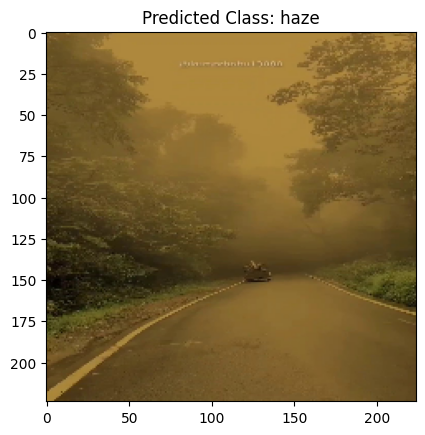

1/1 [==============================] - 0s 87ms/step


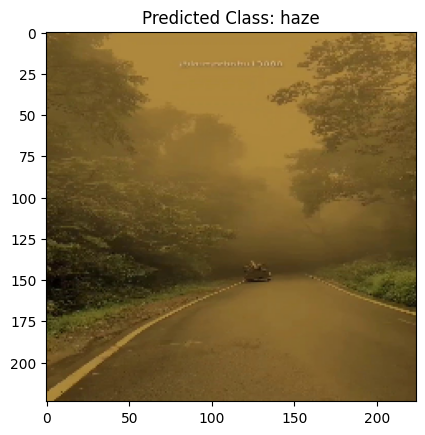

1/1 [==============================] - 0s 96ms/step


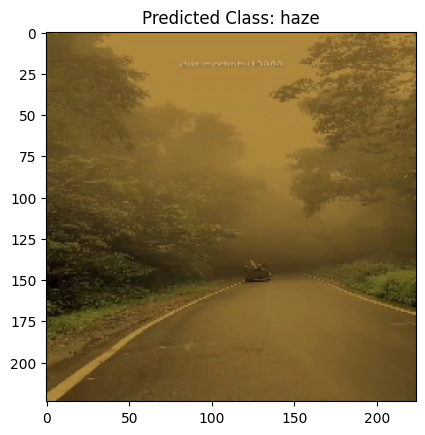

1/1 [==============================] - 0s 78ms/step


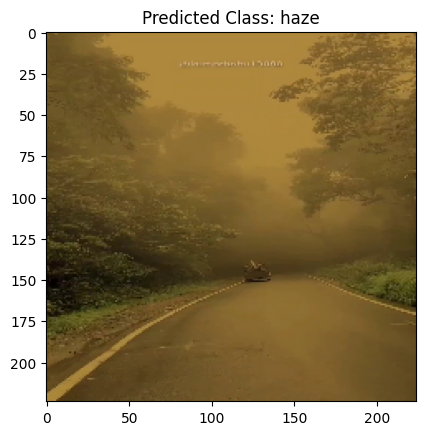

1/1 [==============================] - 0s 91ms/step


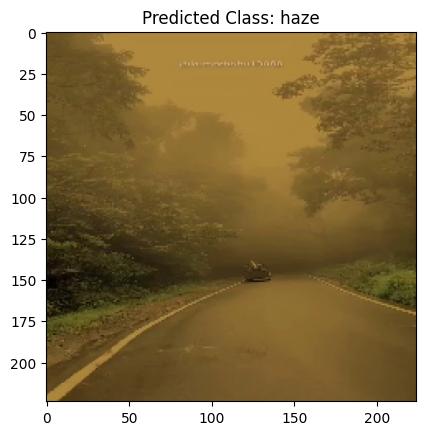

1/1 [==============================] - 0s 90ms/step


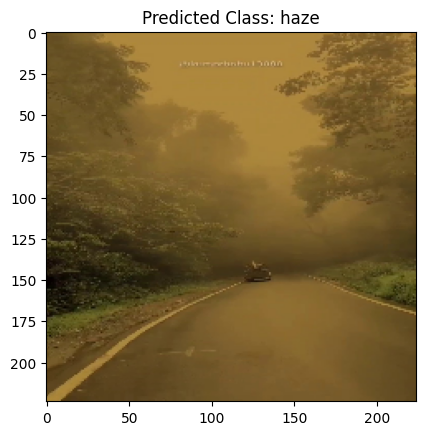

1/1 [==============================] - 0s 92ms/step


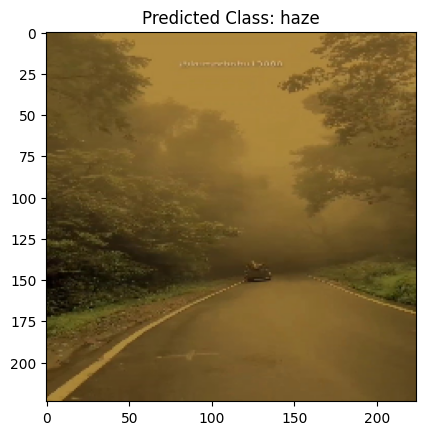

1/1 [==============================] - 0s 90ms/step


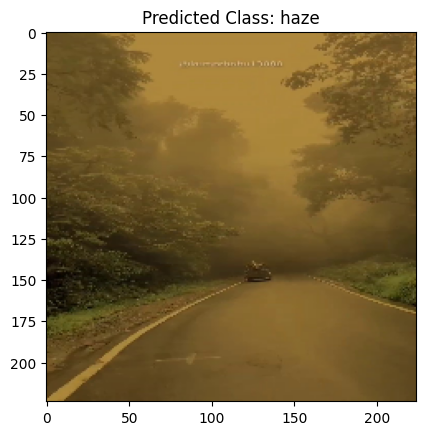

1/1 [==============================] - 0s 91ms/step


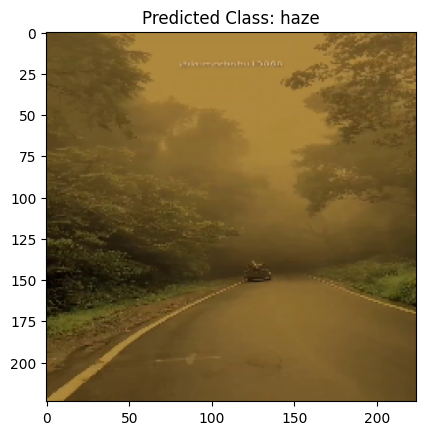

1/1 [==============================] - 0s 92ms/step


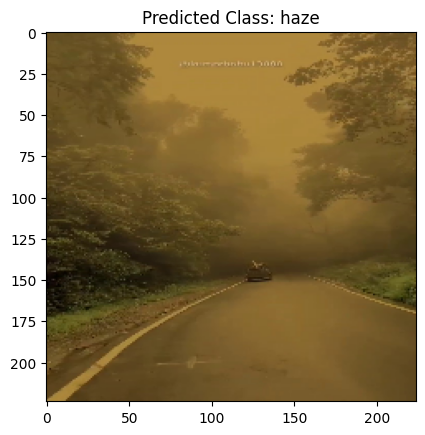

1/1 [==============================] - 0s 79ms/step


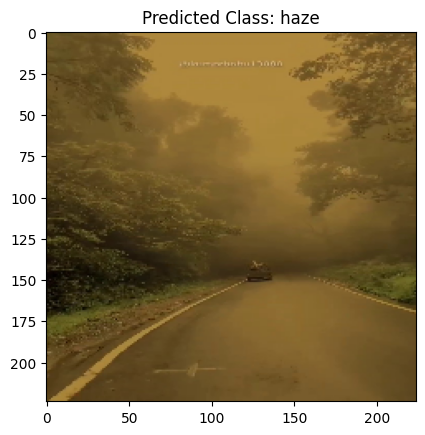

1/1 [==============================] - 0s 80ms/step


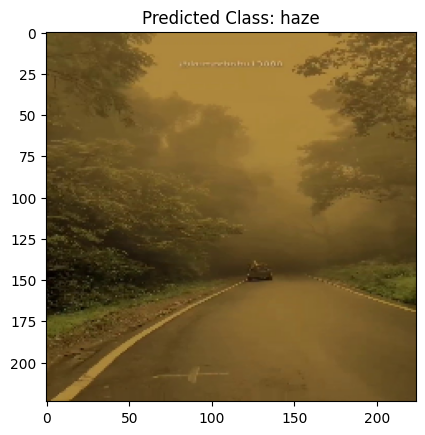

1/1 [==============================] - 0s 88ms/step


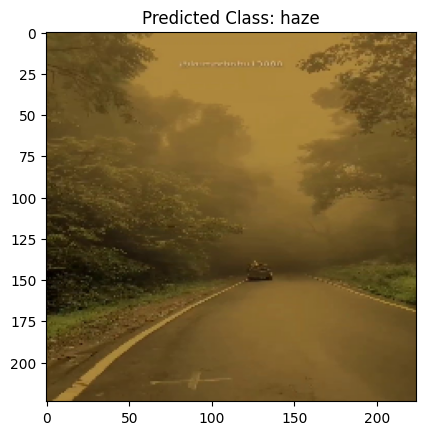

1/1 [==============================] - 0s 90ms/step


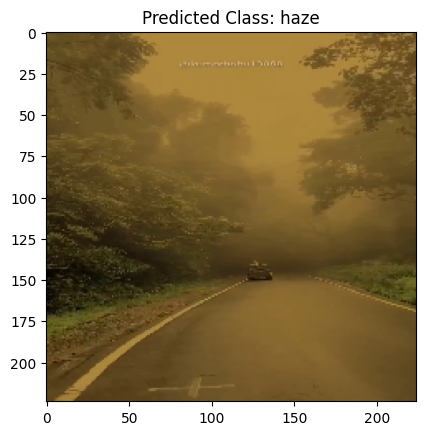

1/1 [==============================] - 0s 99ms/step


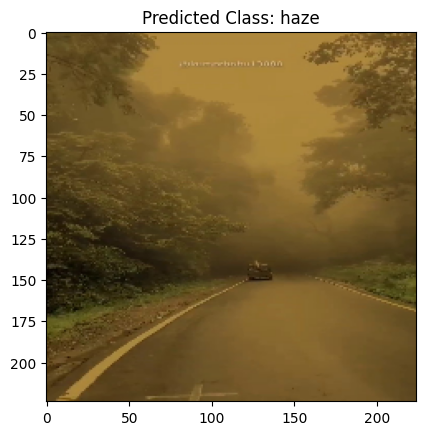

1/1 [==============================] - 0s 94ms/step


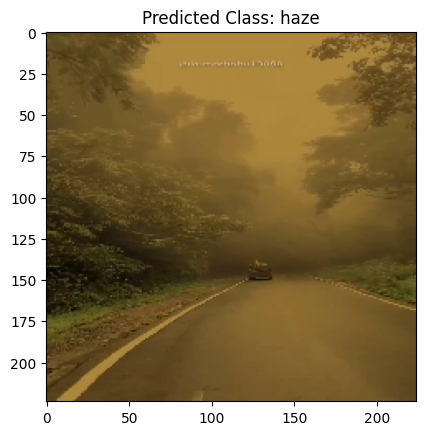

1/1 [==============================] - 0s 89ms/step


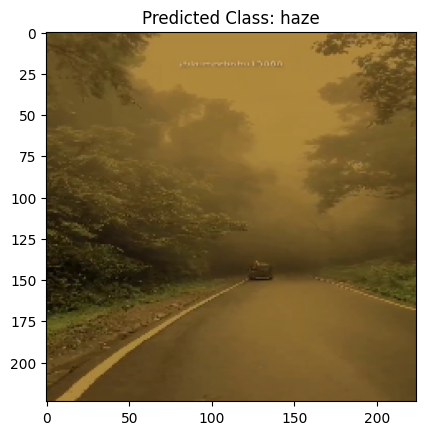

1/1 [==============================] - 0s 97ms/step


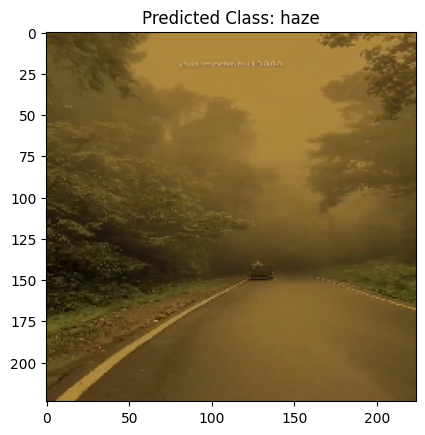

1/1 [==============================] - 0s 76ms/step


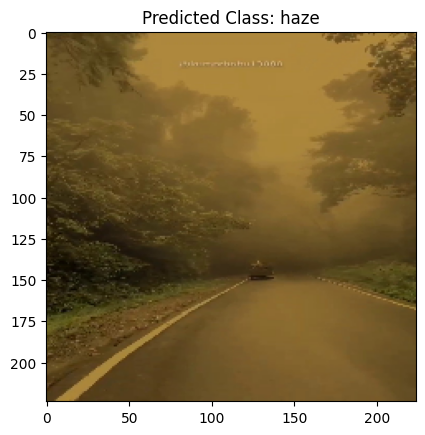

1/1 [==============================] - 0s 98ms/step


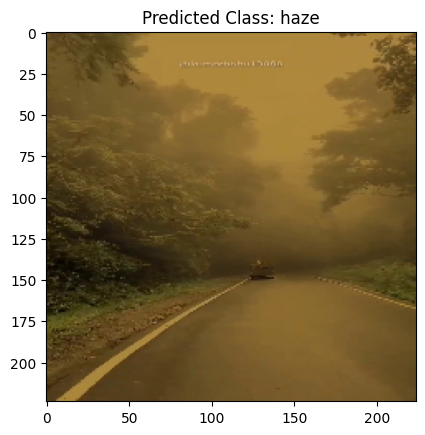

1/1 [==============================] - 0s 90ms/step


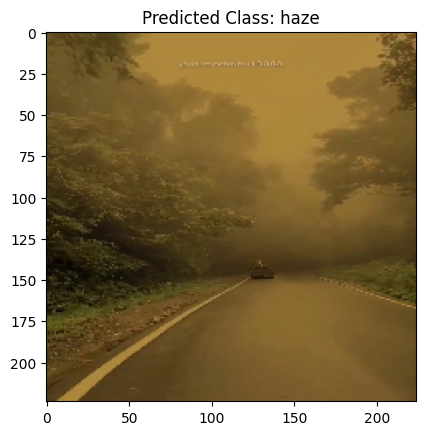

1/1 [==============================] - 0s 84ms/step


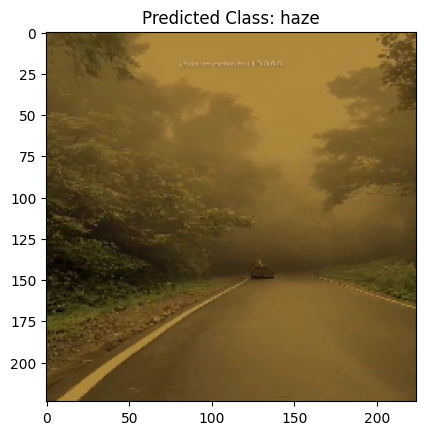

1/1 [==============================] - 0s 79ms/step


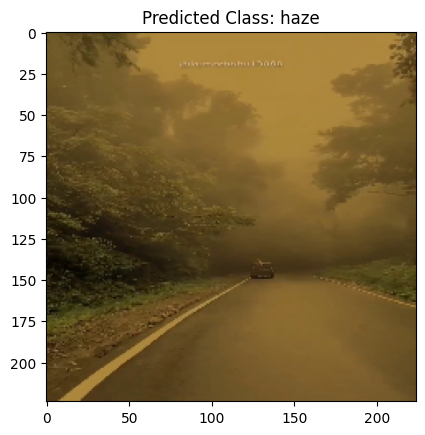

1/1 [==============================] - 0s 88ms/step


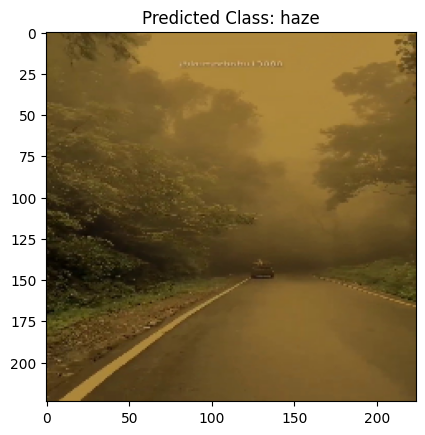

1/1 [==============================] - 0s 87ms/step


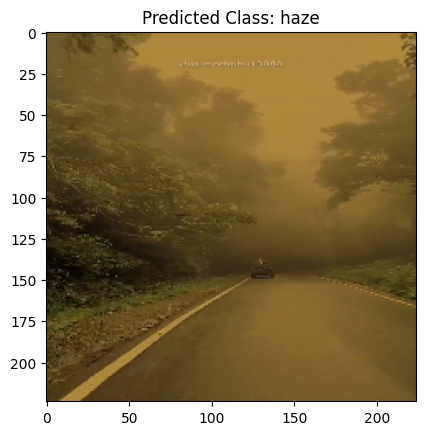

1/1 [==============================] - 0s 76ms/step


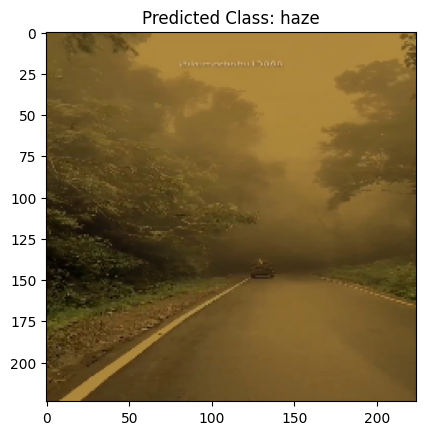

1/1 [==============================] - 0s 84ms/step


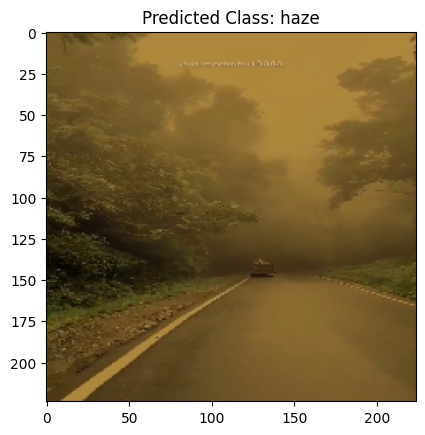

1/1 [==============================] - 0s 97ms/step


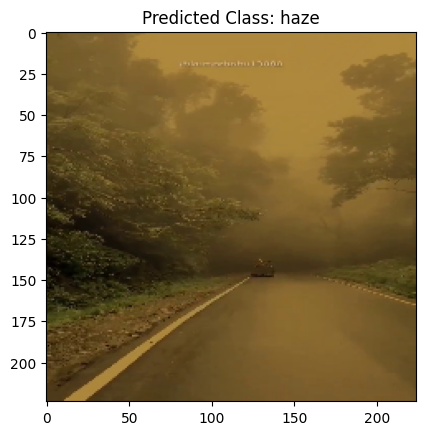

1/1 [==============================] - 0s 96ms/step


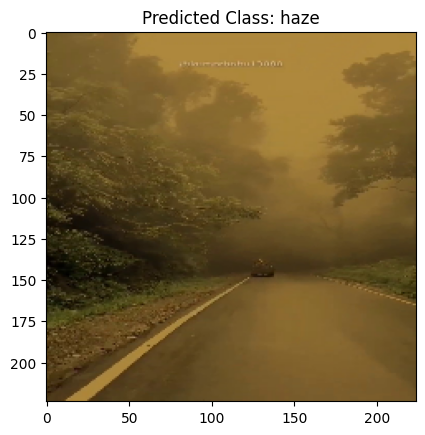

1/1 [==============================] - 0s 94ms/step


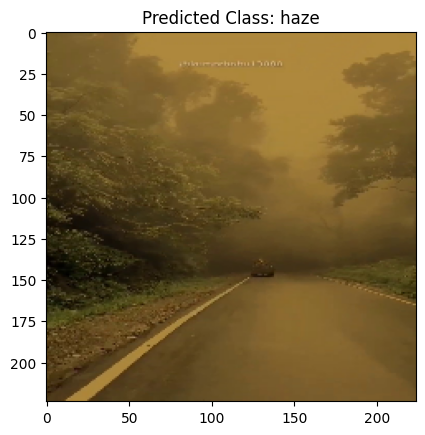

1/1 [==============================] - 0s 100ms/step


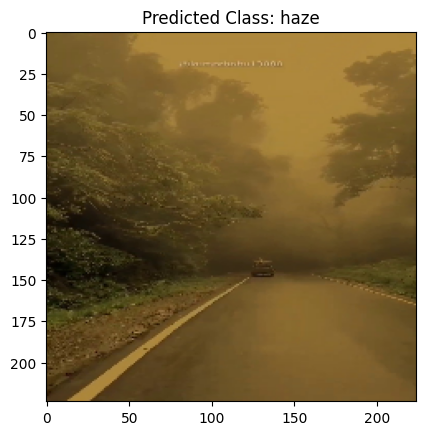

1/1 [==============================] - 0s 94ms/step


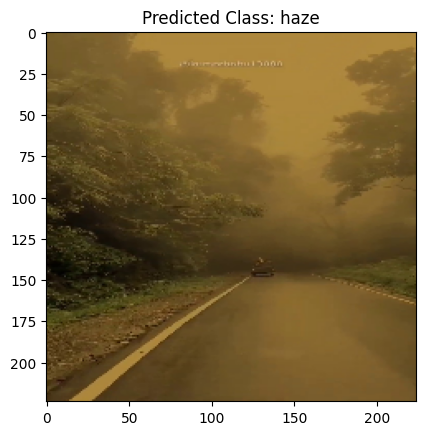

1/1 [==============================] - 0s 100ms/step


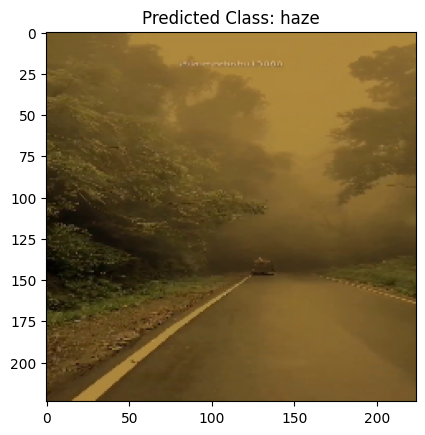

1/1 [==============================] - 0s 111ms/step


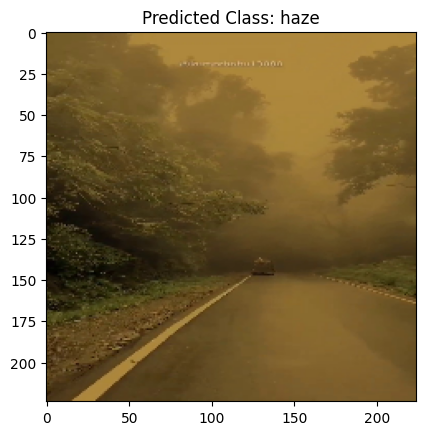

1/1 [==============================] - 0s 110ms/step


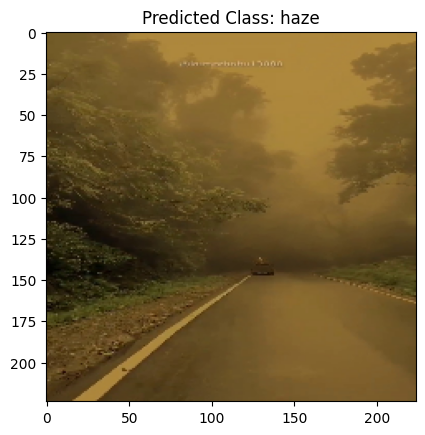

1/1 [==============================] - 0s 99ms/step


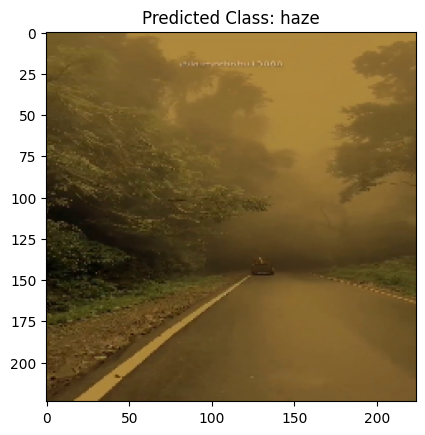

1/1 [==============================] - 0s 98ms/step


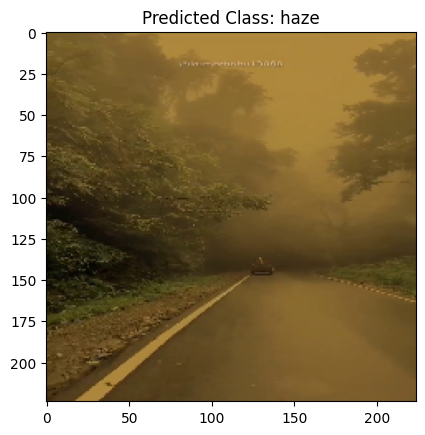

1/1 [==============================] - 0s 90ms/step


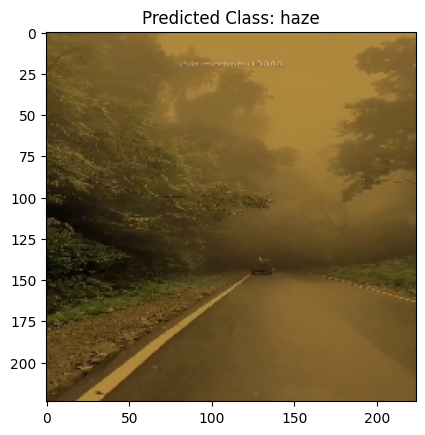

1/1 [==============================] - 0s 100ms/step


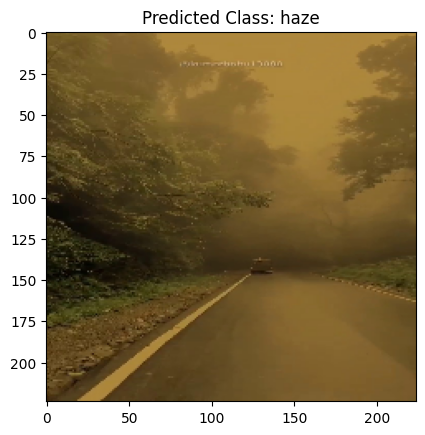

1/1 [==============================] - 0s 108ms/step


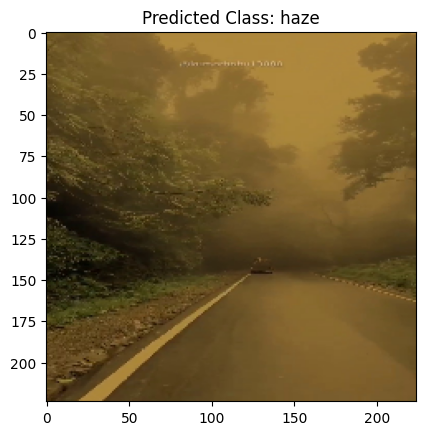

1/1 [==============================] - 0s 108ms/step


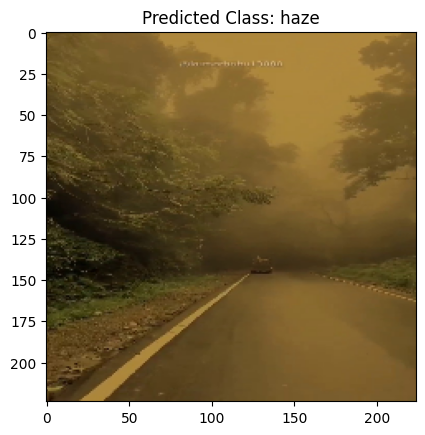

1/1 [==============================] - 0s 116ms/step


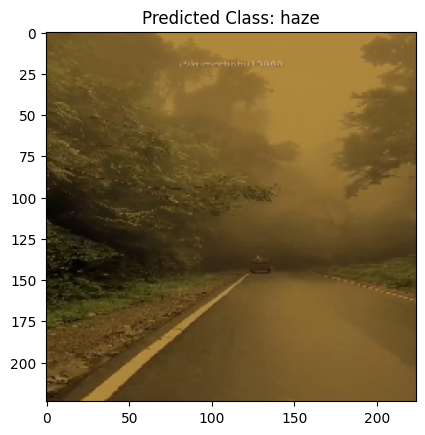

1/1 [==============================] - 0s 104ms/step


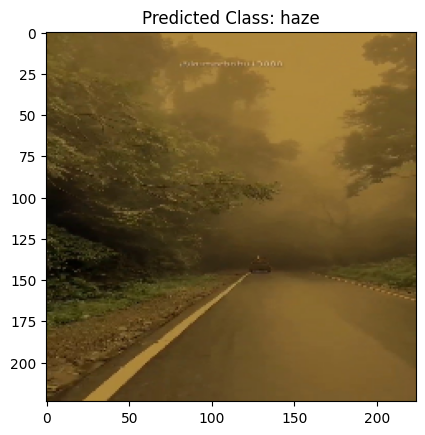

1/1 [==============================] - 0s 103ms/step


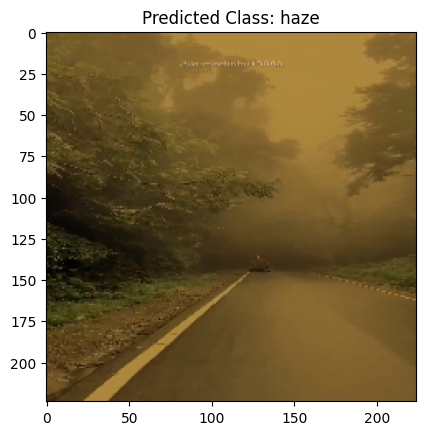

1/1 [==============================] - 0s 103ms/step


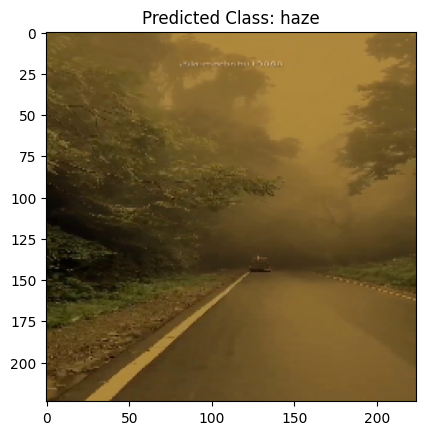

1/1 [==============================] - 0s 104ms/step


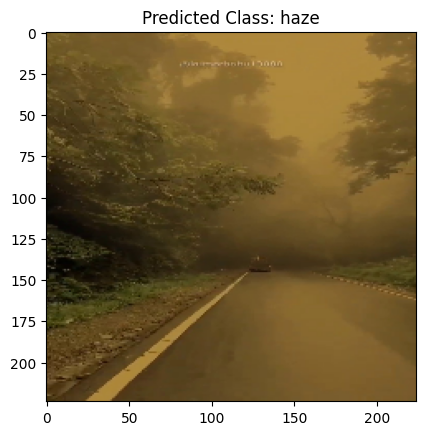

1/1 [==============================] - 0s 96ms/step


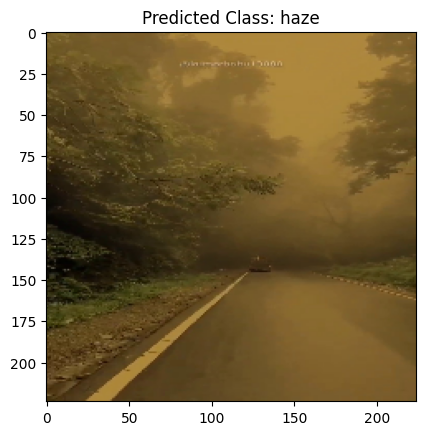

1/1 [==============================] - 0s 79ms/step


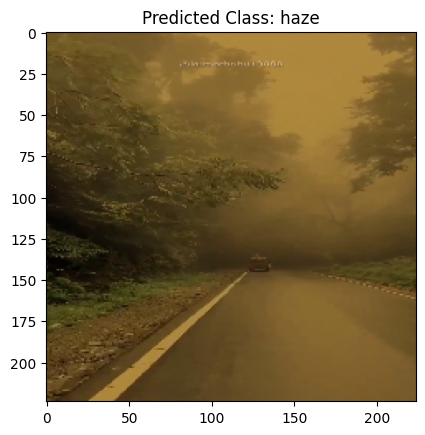

1/1 [==============================] - 0s 95ms/step


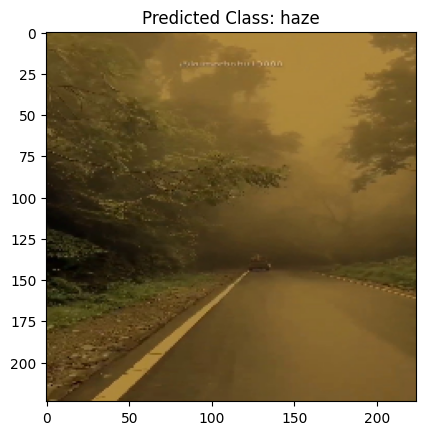

1/1 [==============================] - 0s 85ms/step


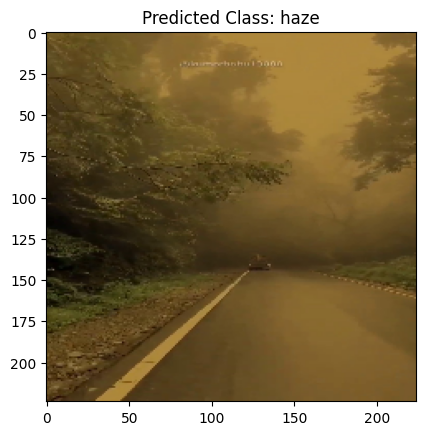

1/1 [==============================] - 0s 97ms/step


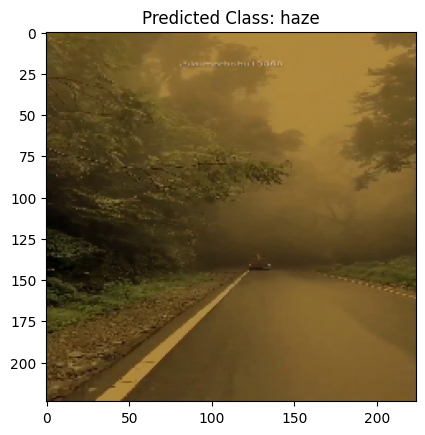

1/1 [==============================] - 0s 101ms/step


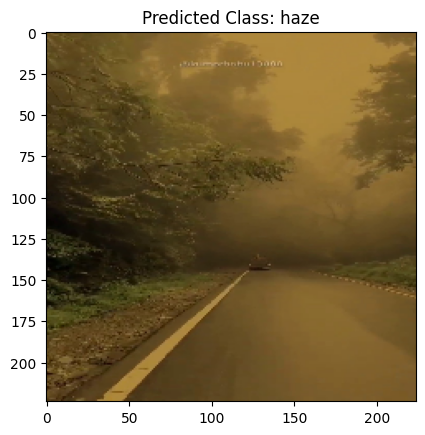

1/1 [==============================] - 0s 88ms/step


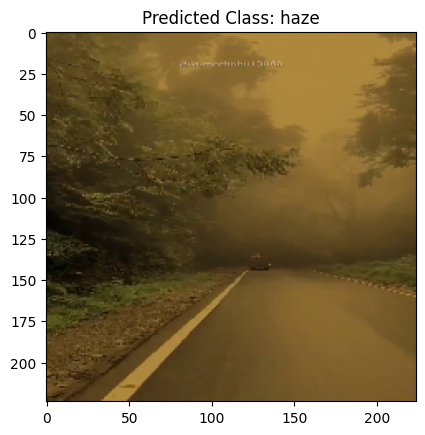

1/1 [==============================] - 0s 104ms/step


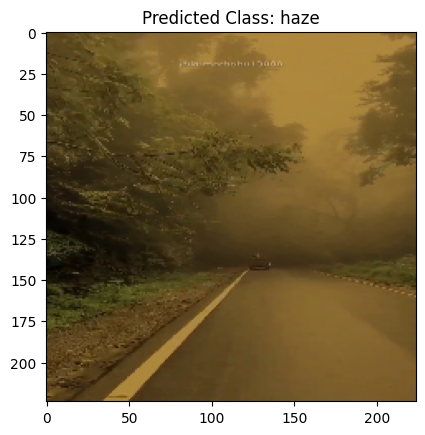

1/1 [==============================] - 0s 94ms/step


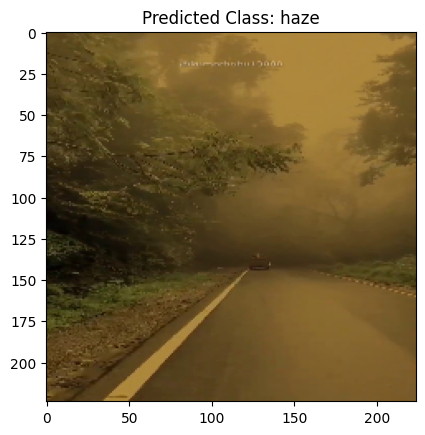

1/1 [==============================] - 0s 95ms/step


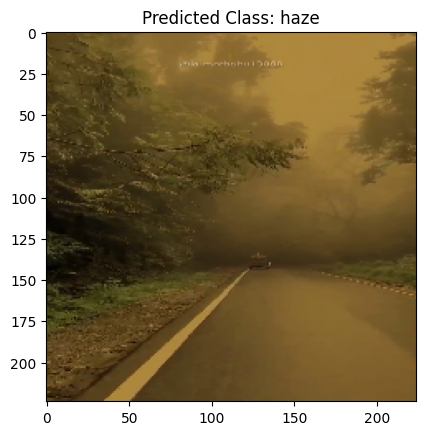

1/1 [==============================] - 0s 97ms/step


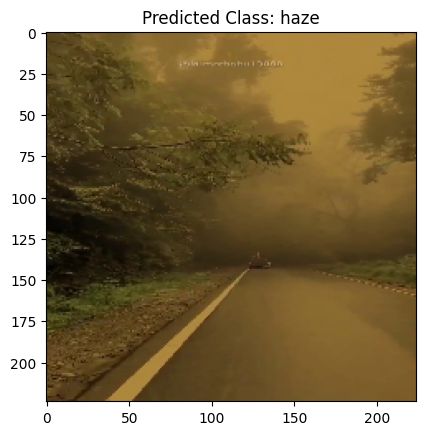

1/1 [==============================] - 0s 93ms/step


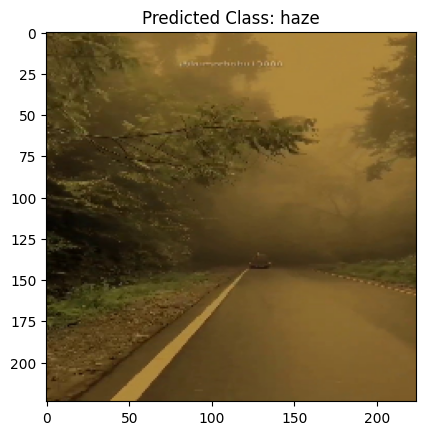

1/1 [==============================] - 0s 96ms/step


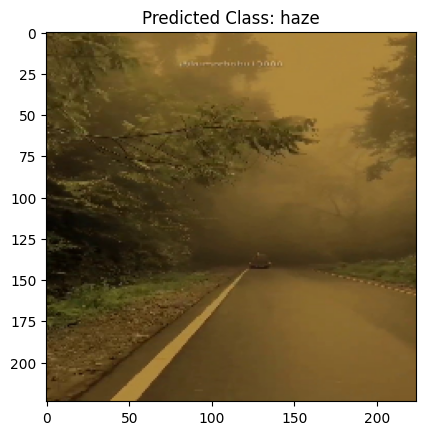

1/1 [==============================] - 0s 94ms/step


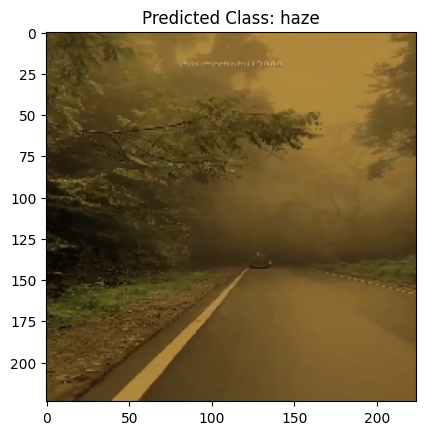

1/1 [==============================] - 0s 101ms/step


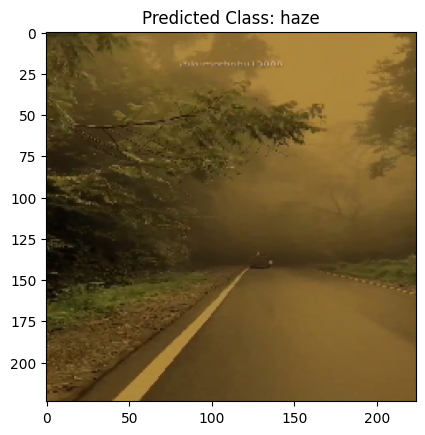

1/1 [==============================] - 0s 86ms/step


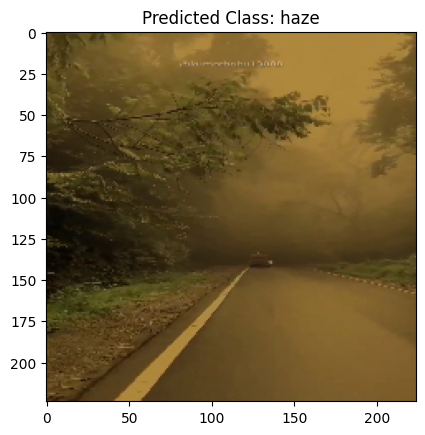

1/1 [==============================] - 0s 100ms/step


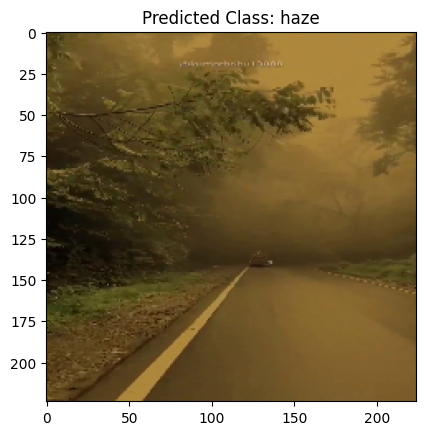

1/1 [==============================] - 0s 85ms/step


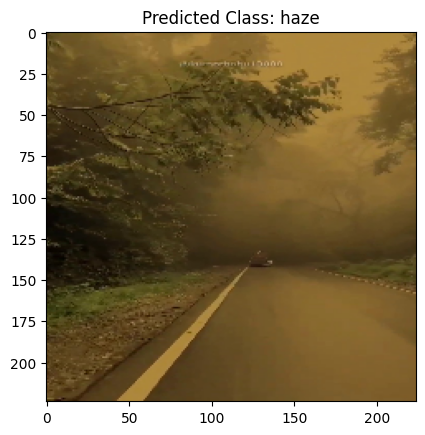

1/1 [==============================] - 0s 91ms/step


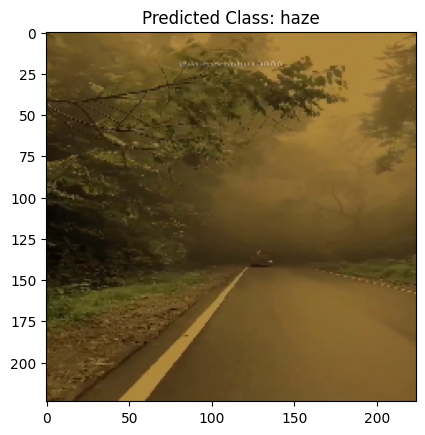

1/1 [==============================] - 0s 99ms/step


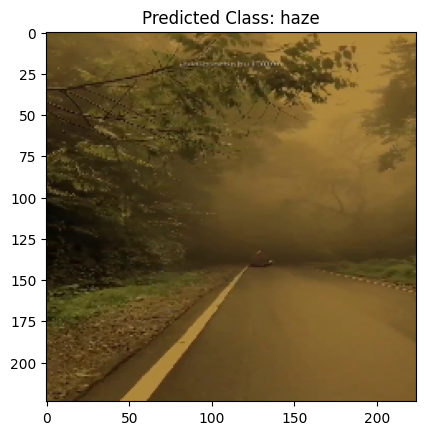

1/1 [==============================] - 0s 96ms/step


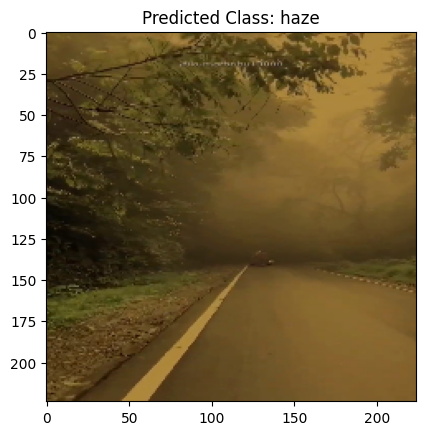

1/1 [==============================] - 0s 111ms/step


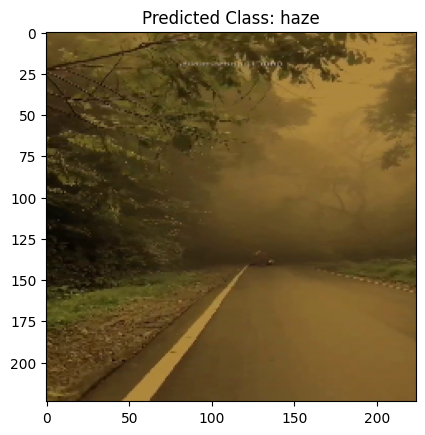

1/1 [==============================] - 0s 104ms/step


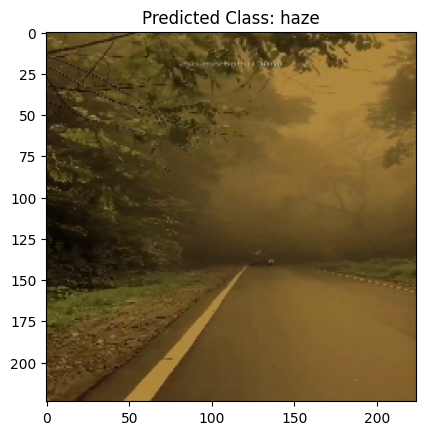

1/1 [==============================] - 0s 97ms/step


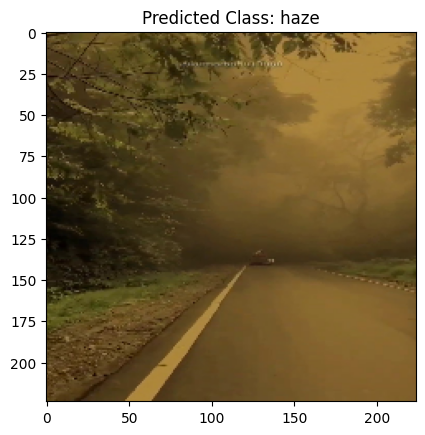

1/1 [==============================] - 0s 104ms/step


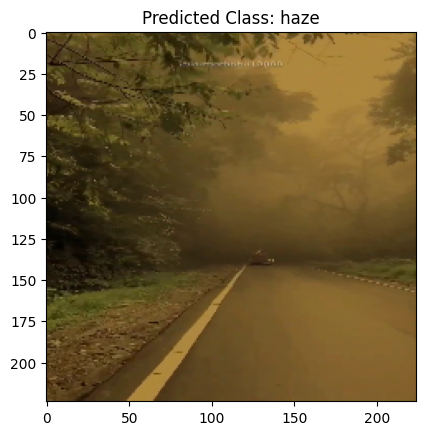

1/1 [==============================] - 0s 103ms/step


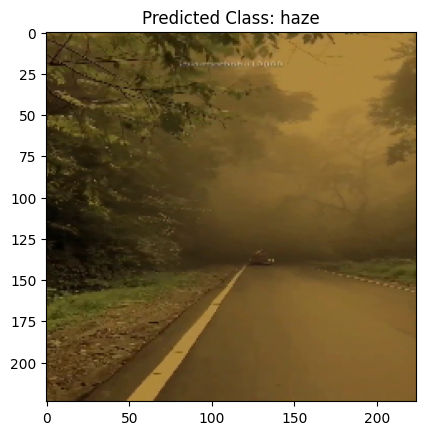

1/1 [==============================] - 0s 103ms/step


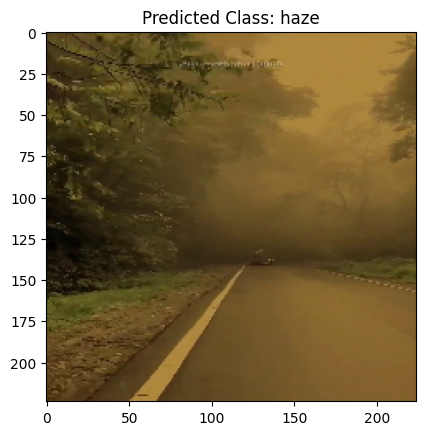

1/1 [==============================] - 0s 102ms/step


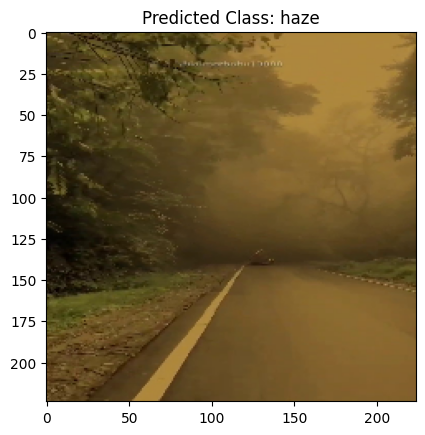

1/1 [==============================] - 0s 94ms/step


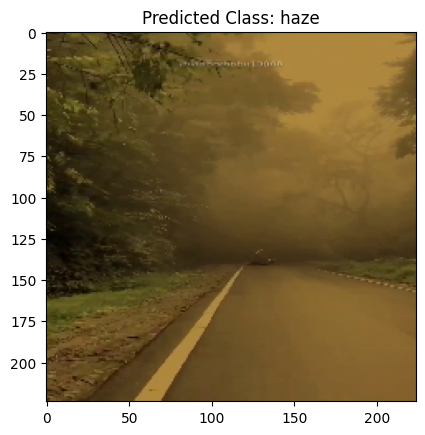

1/1 [==============================] - 0s 97ms/step


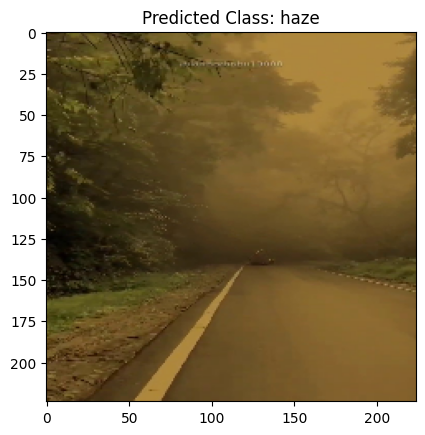

1/1 [==============================] - 0s 107ms/step


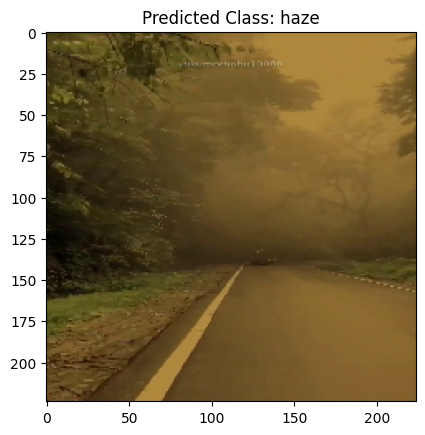

1/1 [==============================] - 0s 98ms/step


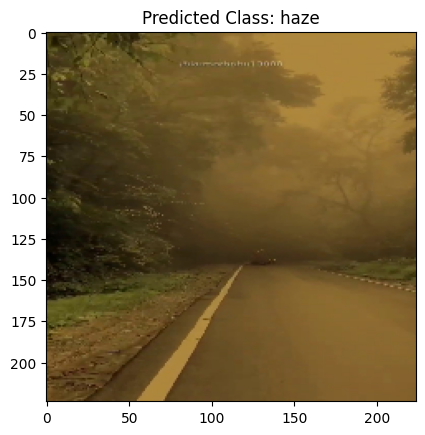

1/1 [==============================] - 0s 100ms/step


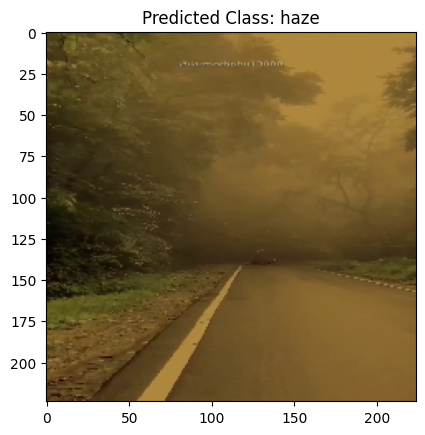

1/1 [==============================] - 0s 95ms/step


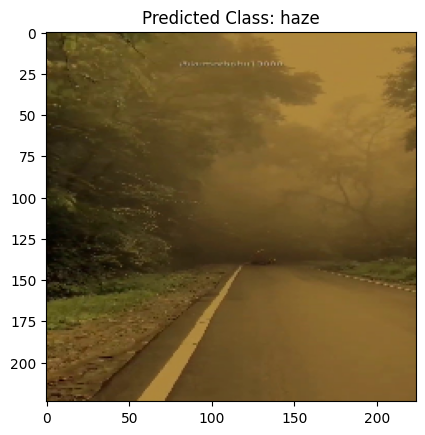

1/1 [==============================] - 0s 94ms/step


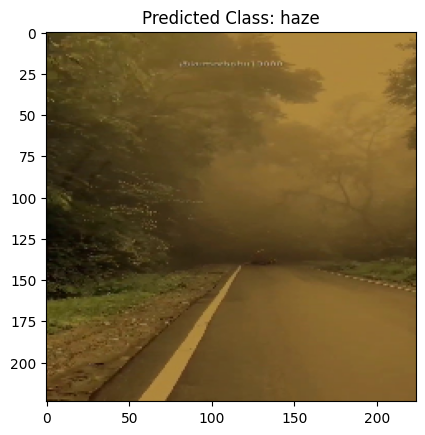

1/1 [==============================] - 0s 102ms/step


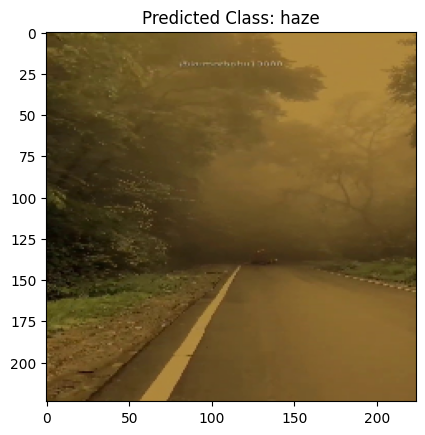

1/1 [==============================] - 0s 102ms/step


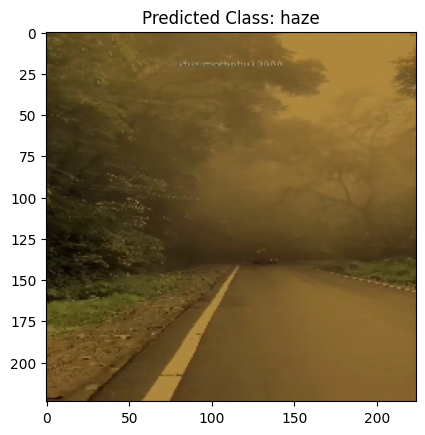

1/1 [==============================] - 0s 94ms/step


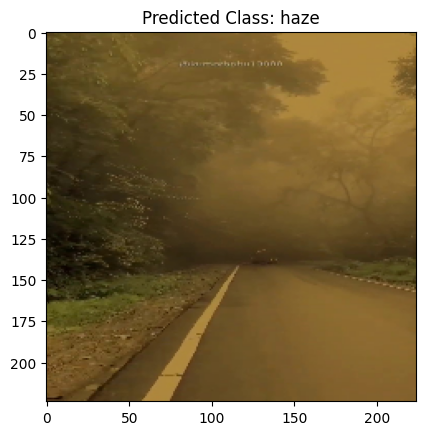

1/1 [==============================] - 0s 92ms/step


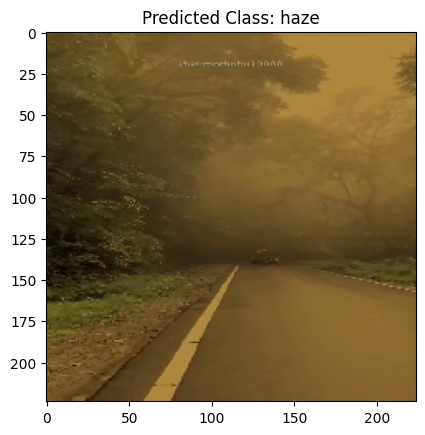

1/1 [==============================] - 0s 90ms/step


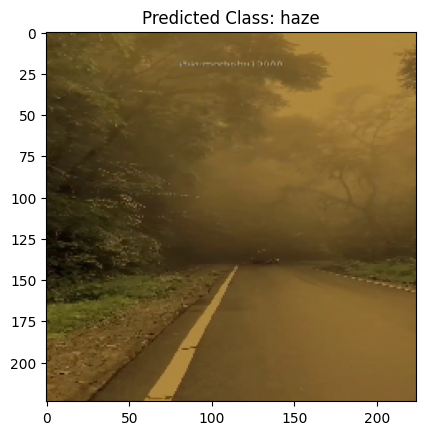

1/1 [==============================] - 0s 95ms/step


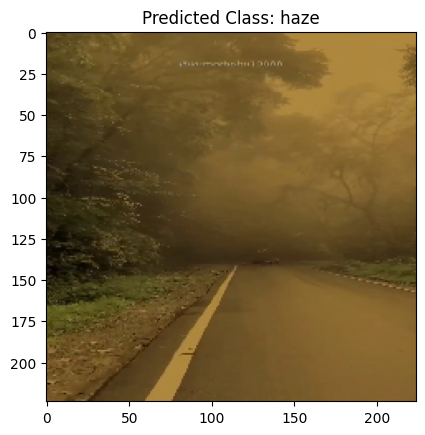

1/1 [==============================] - 0s 94ms/step


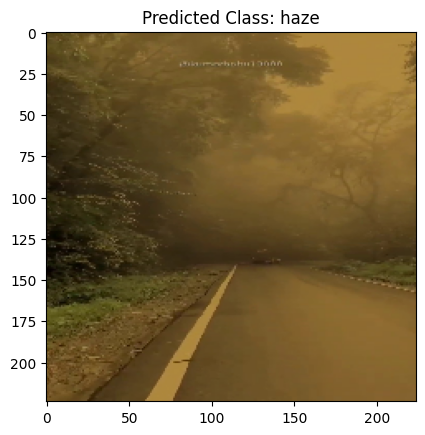

1/1 [==============================] - 0s 99ms/step


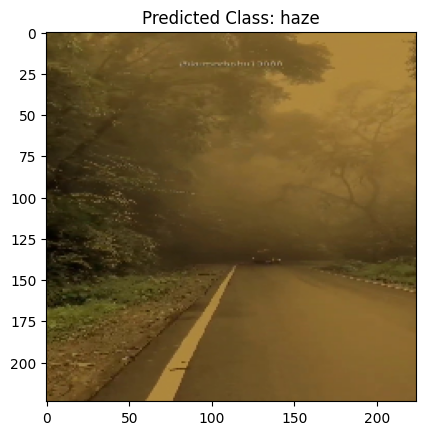

1/1 [==============================] - 0s 90ms/step


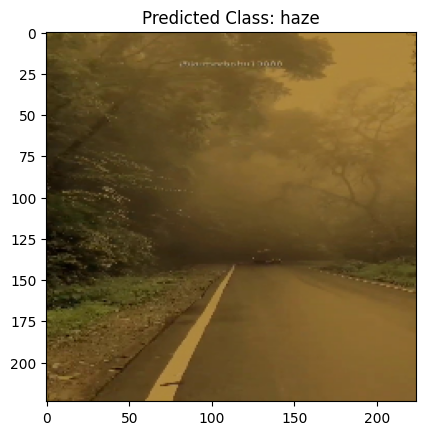

1/1 [==============================] - 0s 96ms/step


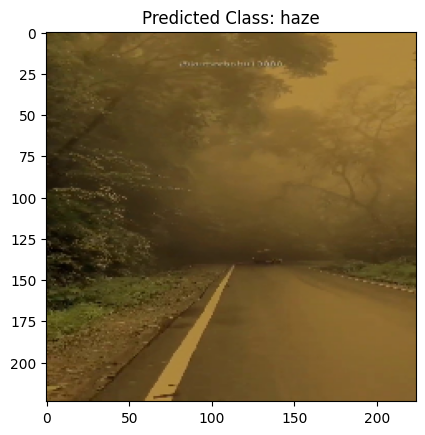

1/1 [==============================] - 0s 95ms/step


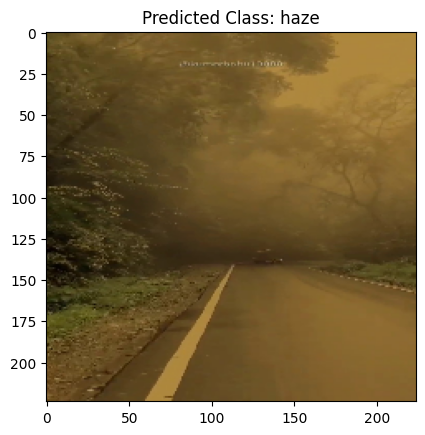

1/1 [==============================] - 0s 95ms/step


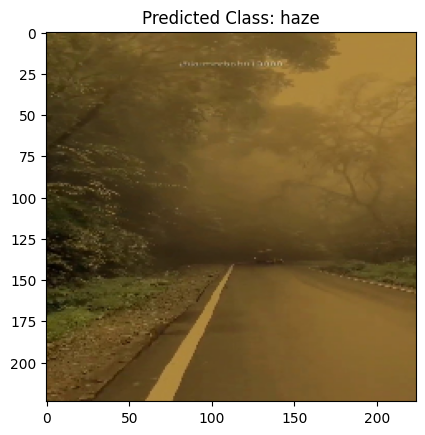

1/1 [==============================] - 0s 83ms/step


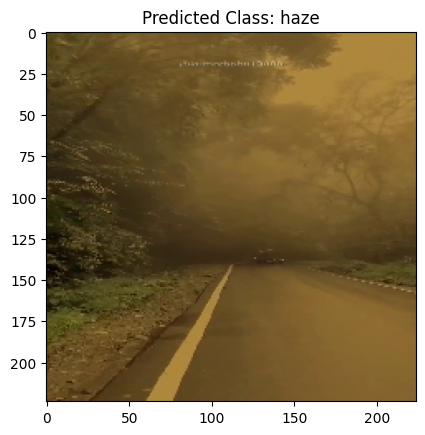

1/1 [==============================] - 0s 102ms/step


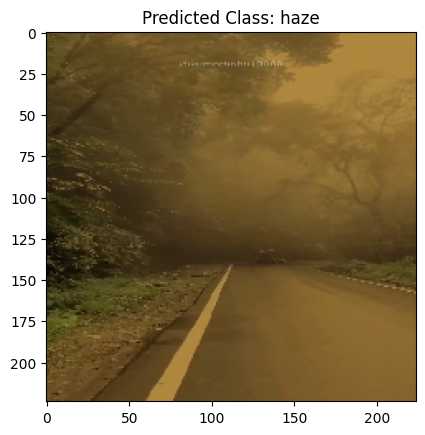

1/1 [==============================] - 0s 100ms/step


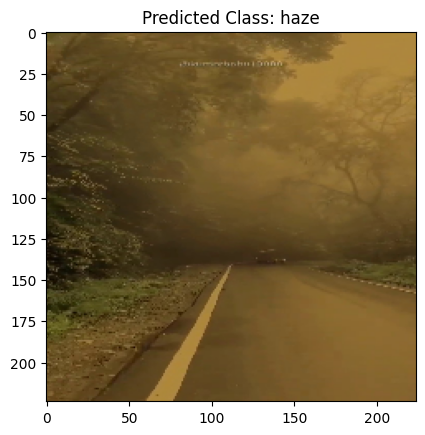

1/1 [==============================] - 0s 88ms/step


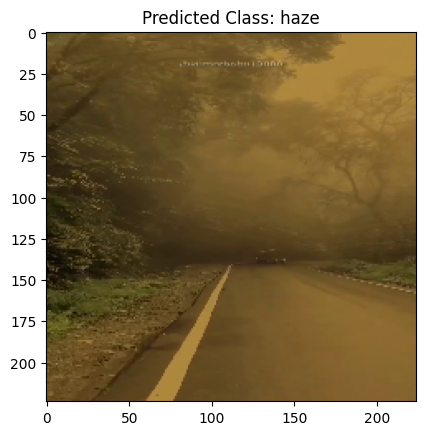

1/1 [==============================] - 0s 91ms/step


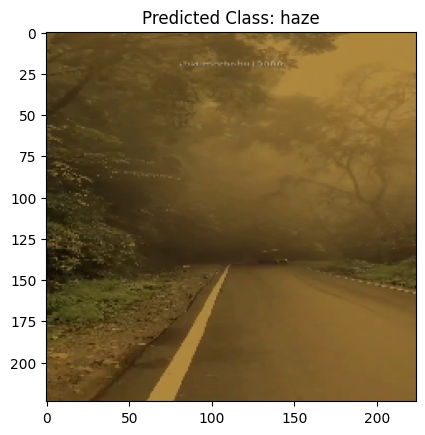

1/1 [==============================] - 0s 100ms/step


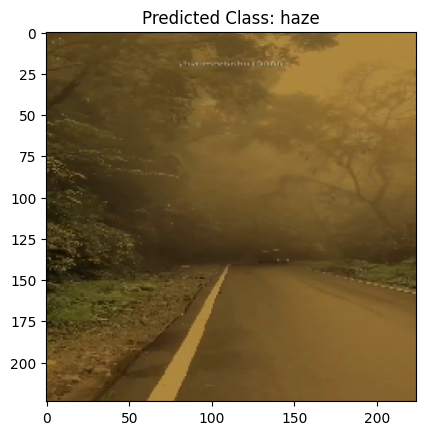

1/1 [==============================] - 0s 94ms/step


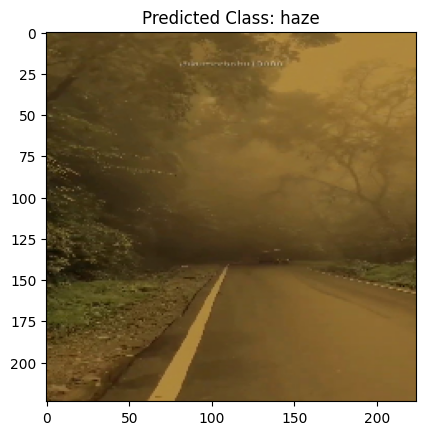

1/1 [==============================] - 0s 100ms/step


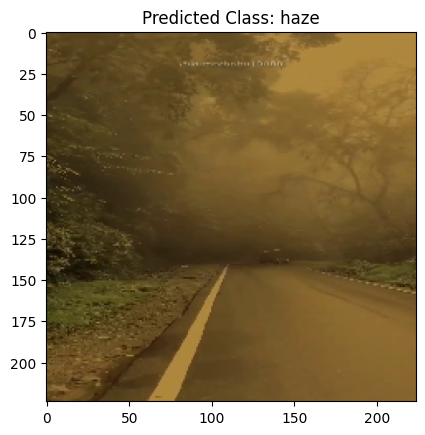

1/1 [==============================] - 0s 103ms/step


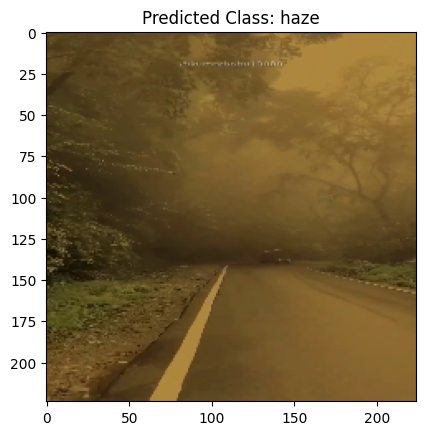

1/1 [==============================] - 0s 99ms/step


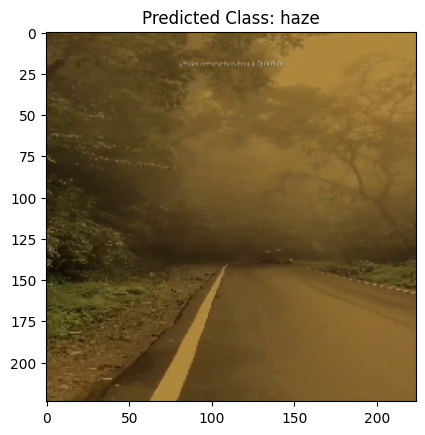

1/1 [==============================] - 0s 96ms/step


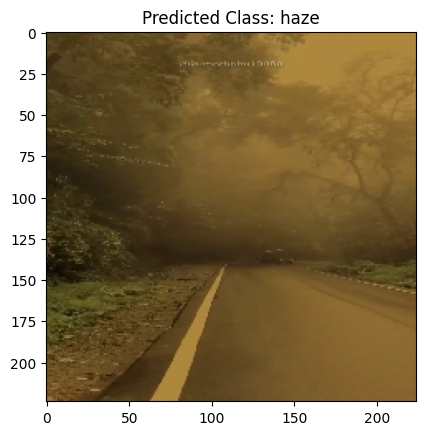

1/1 [==============================] - 0s 104ms/step


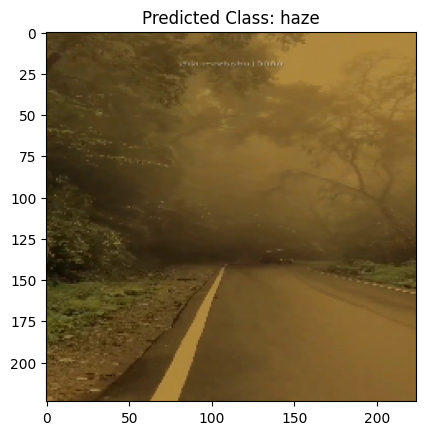

1/1 [==============================] - 0s 100ms/step


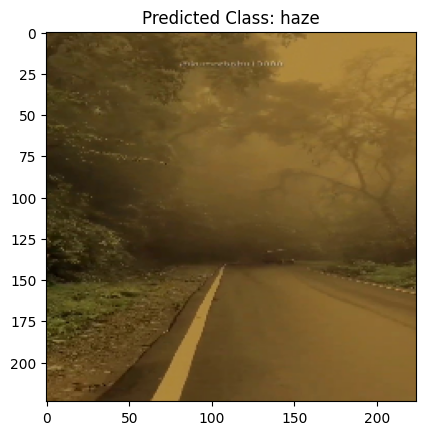

1/1 [==============================] - 0s 106ms/step


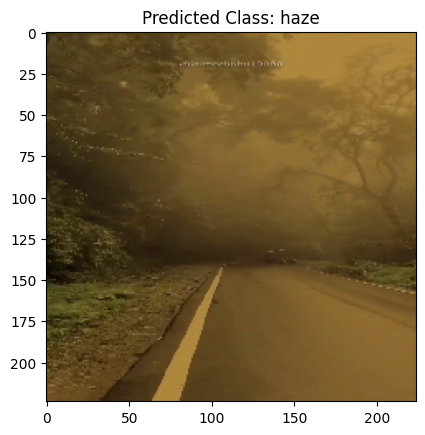

1/1 [==============================] - 0s 87ms/step


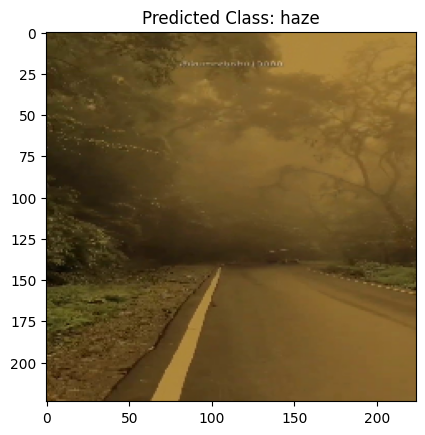

1/1 [==============================] - 0s 98ms/step


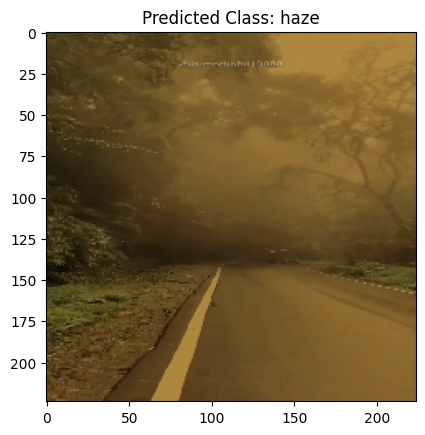

1/1 [==============================] - 0s 99ms/step


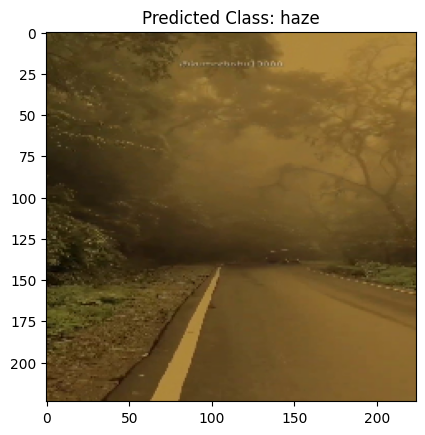

1/1 [==============================] - 0s 96ms/step


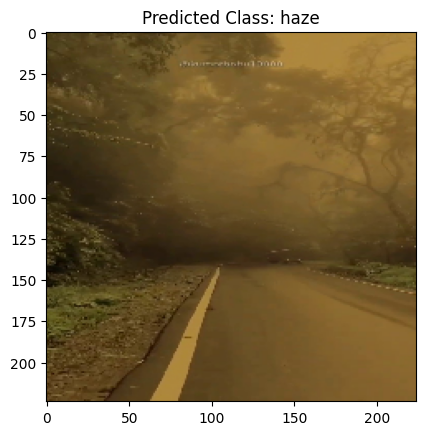

1/1 [==============================] - 0s 107ms/step


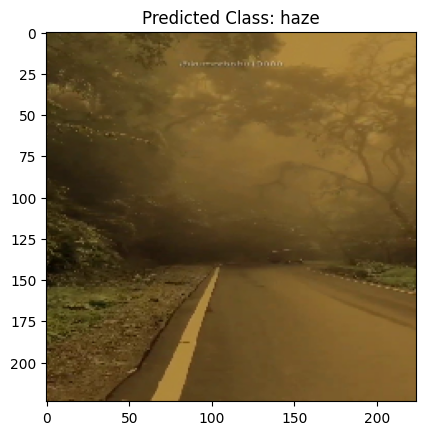

1/1 [==============================] - 0s 88ms/step


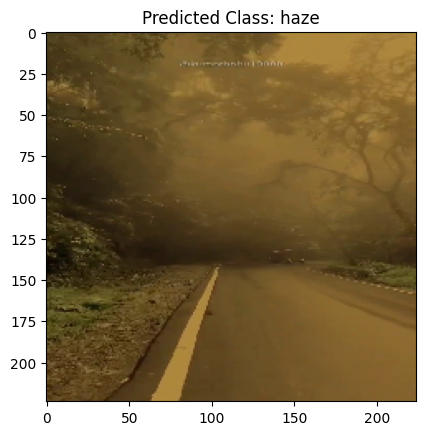

1/1 [==============================] - 0s 99ms/step


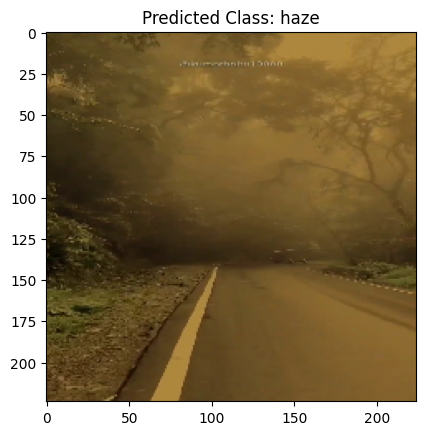

1/1 [==============================] - 0s 97ms/step


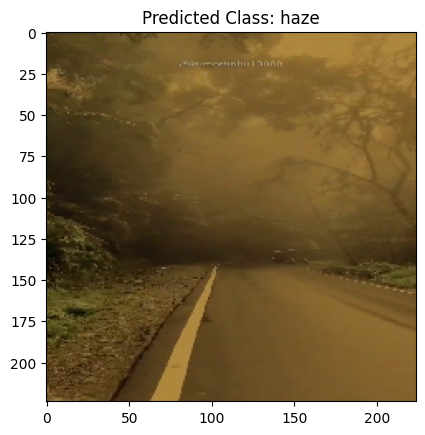

1/1 [==============================] - 0s 96ms/step


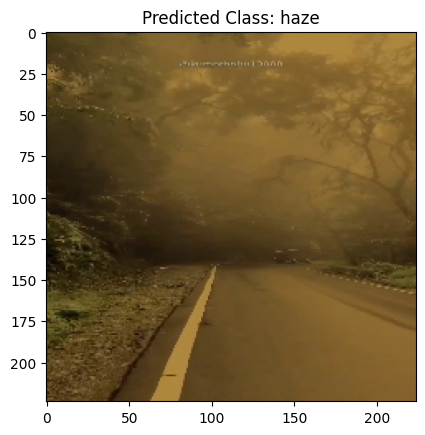

1/1 [==============================] - 0s 100ms/step


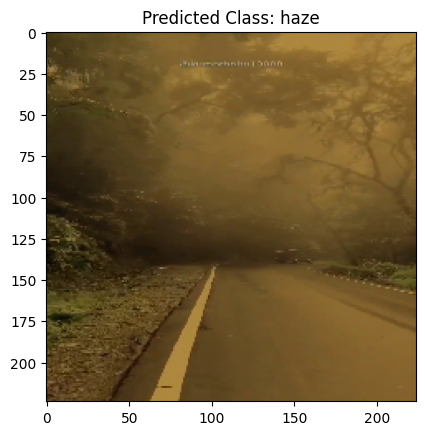

1/1 [==============================] - 0s 102ms/step


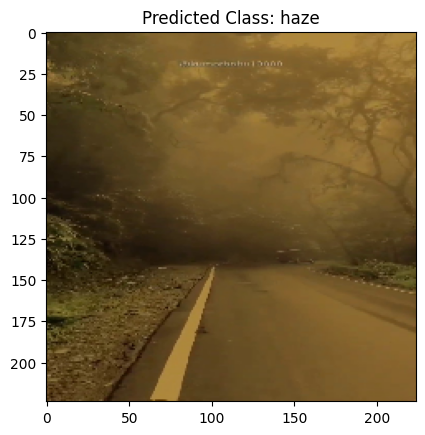

1/1 [==============================] - 0s 107ms/step


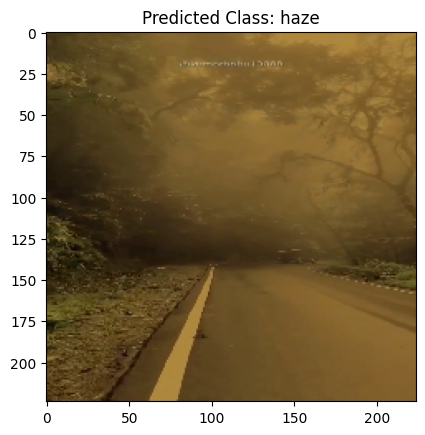

1/1 [==============================] - 0s 88ms/step


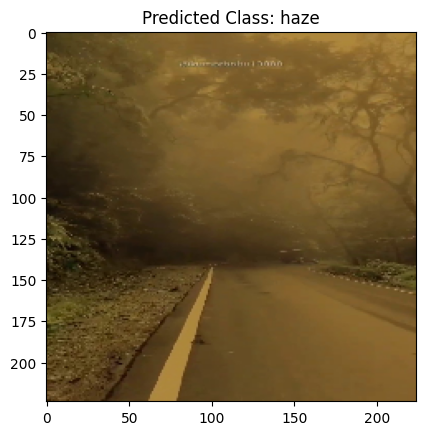

1/1 [==============================] - 0s 89ms/step


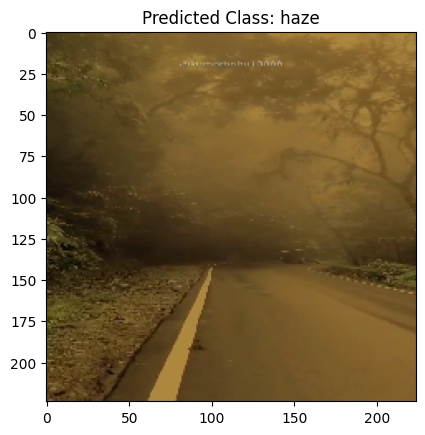

1/1 [==============================] - 0s 100ms/step


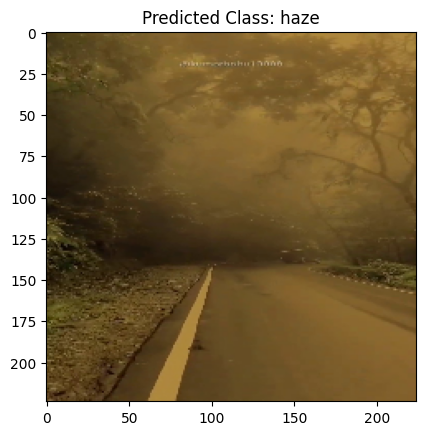

1/1 [==============================] - 0s 100ms/step


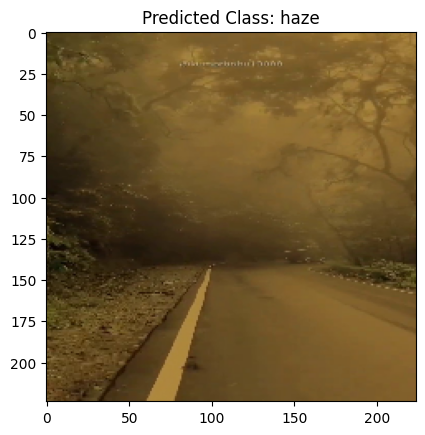

1/1 [==============================] - 0s 96ms/step


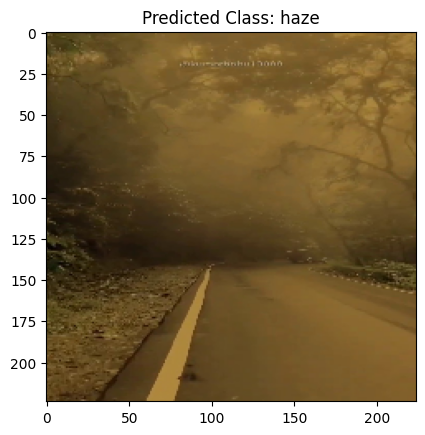

1/1 [==============================] - 0s 96ms/step


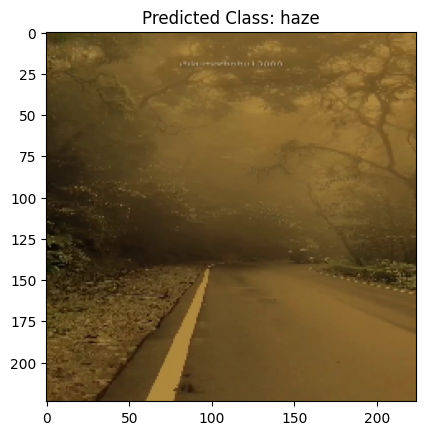

1/1 [==============================] - 0s 106ms/step


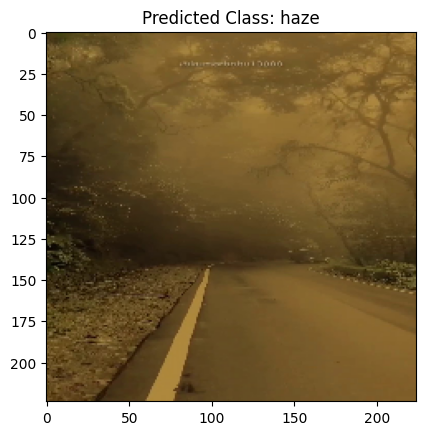

1/1 [==============================] - 0s 91ms/step


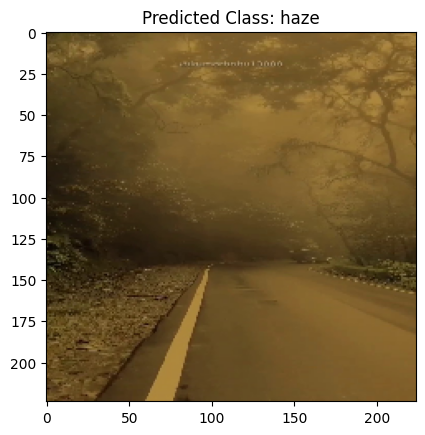

1/1 [==============================] - 0s 96ms/step


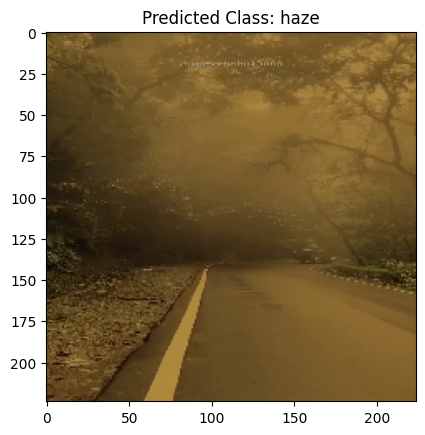

1/1 [==============================] - 0s 94ms/step


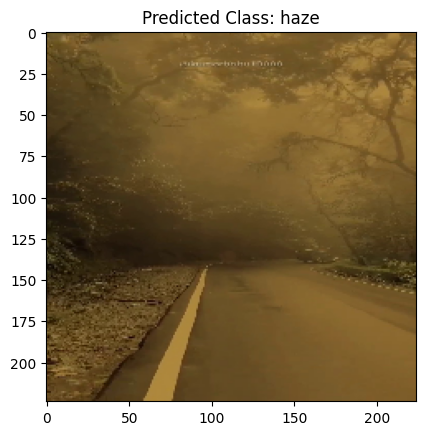

1/1 [==============================] - 0s 96ms/step


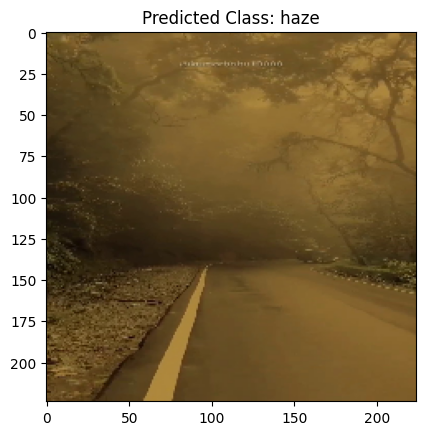

1/1 [==============================] - 0s 90ms/step


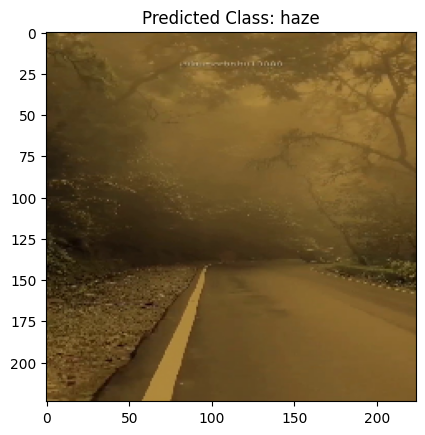

1/1 [==============================] - 0s 88ms/step


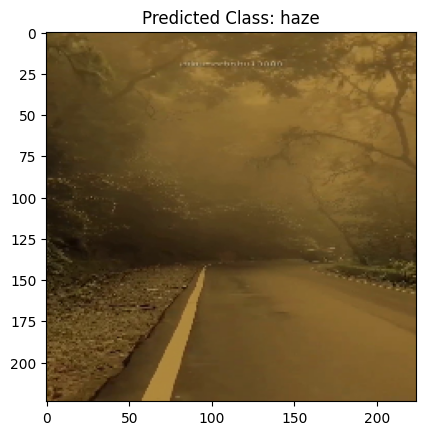

1/1 [==============================] - 0s 88ms/step


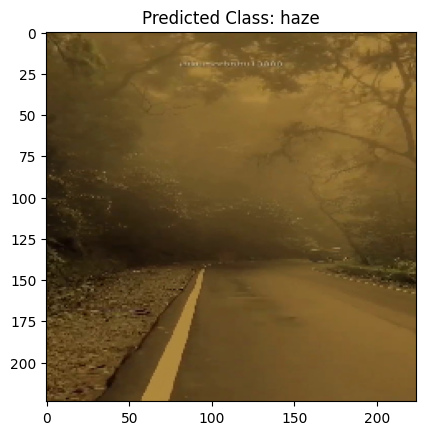

1/1 [==============================] - 0s 88ms/step


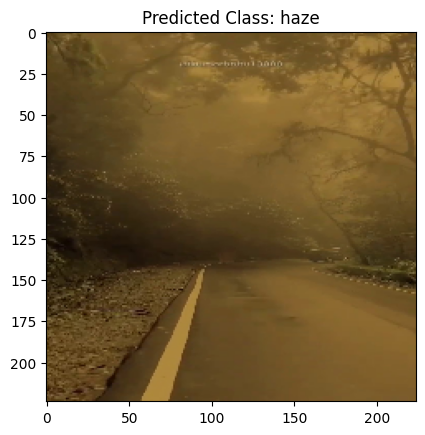

1/1 [==============================] - 0s 88ms/step


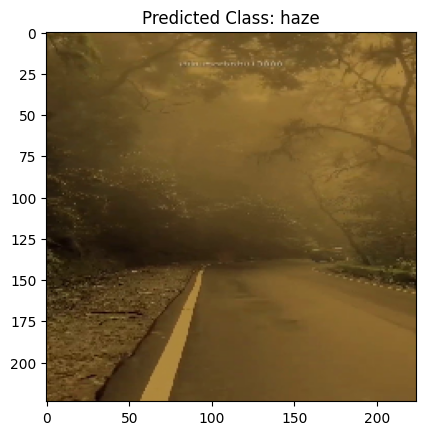

1/1 [==============================] - 0s 101ms/step


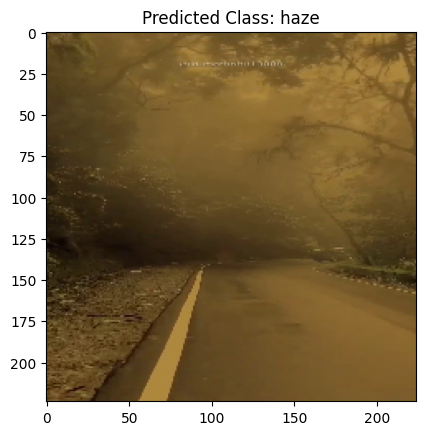

1/1 [==============================] - 0s 89ms/step


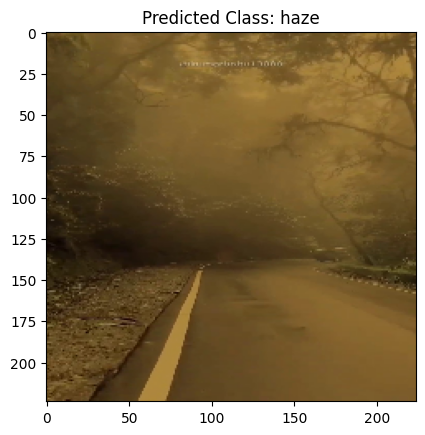

1/1 [==============================] - 0s 88ms/step


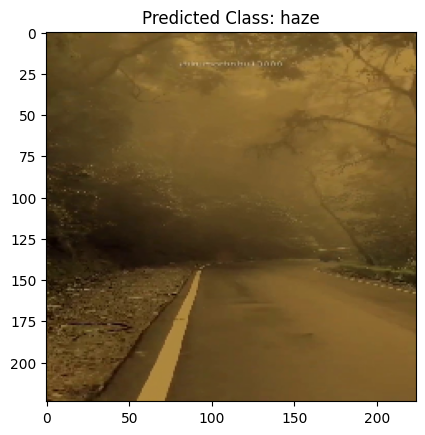

1/1 [==============================] - 0s 100ms/step


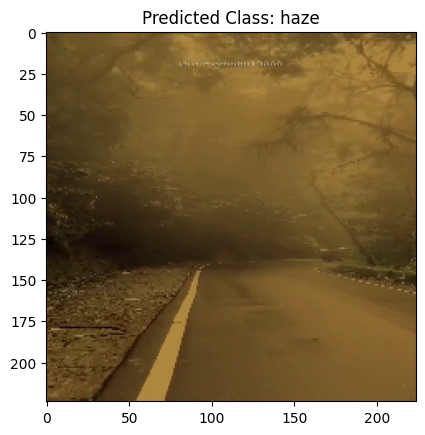

1/1 [==============================] - 0s 107ms/step


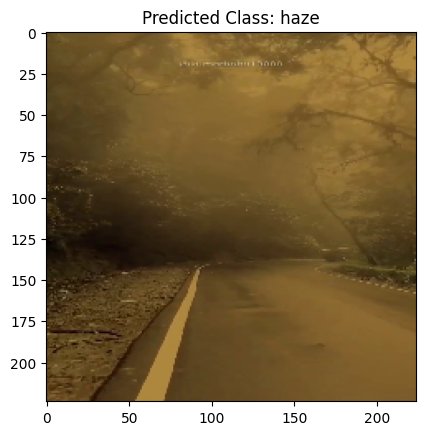

1/1 [==============================] - 0s 91ms/step


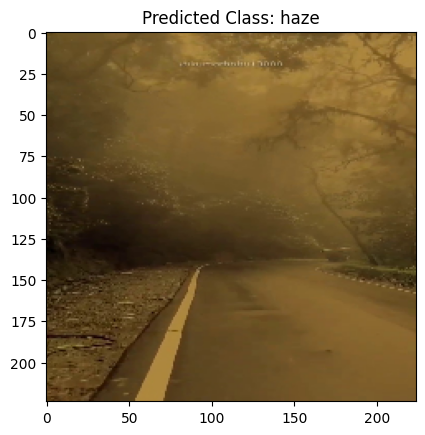

1/1 [==============================] - 0s 98ms/step


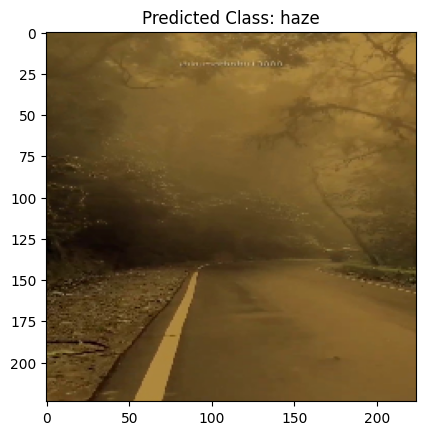

1/1 [==============================] - 0s 115ms/step


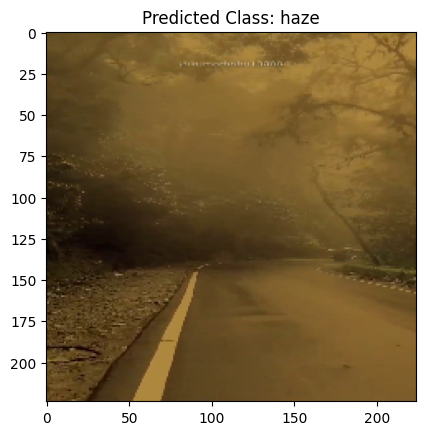

1/1 [==============================] - 0s 100ms/step


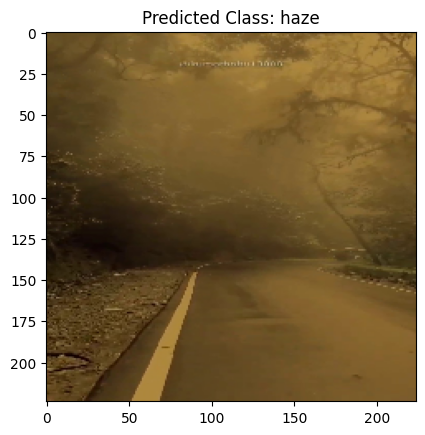

1/1 [==============================] - 0s 99ms/step


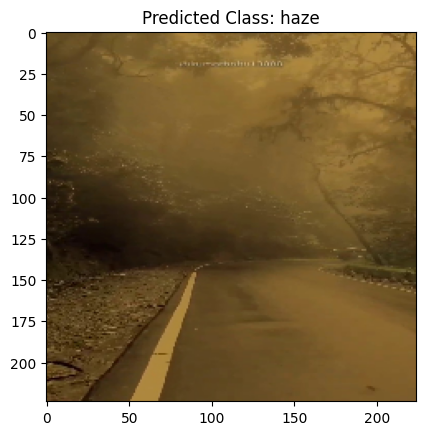

1/1 [==============================] - 0s 85ms/step


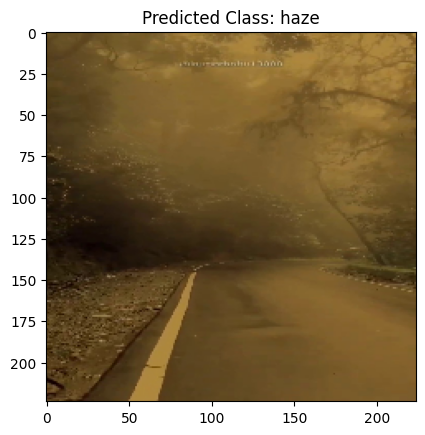

1/1 [==============================] - 0s 97ms/step


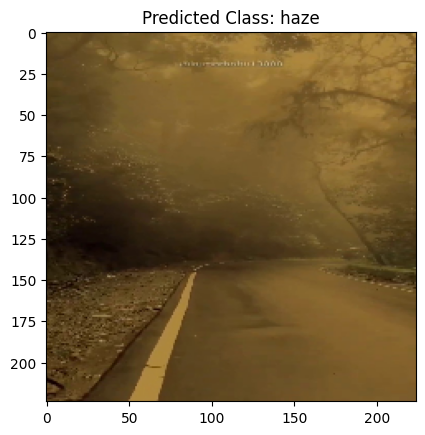

1/1 [==============================] - 0s 91ms/step


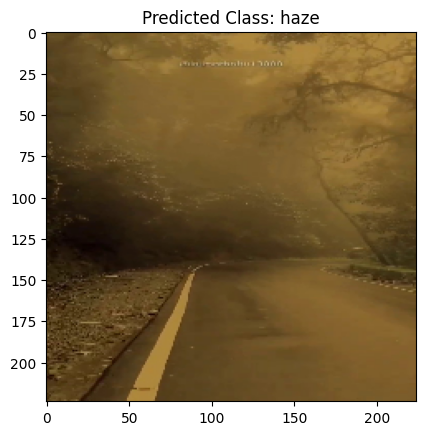

1/1 [==============================] - 0s 87ms/step


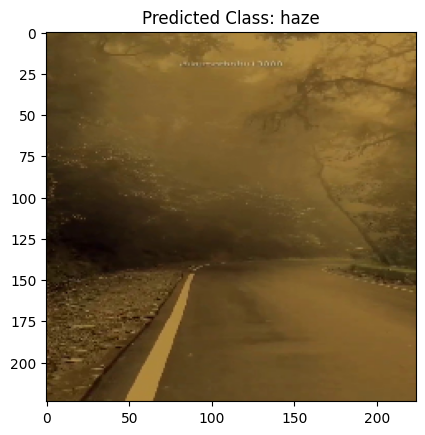

1/1 [==============================] - 0s 96ms/step


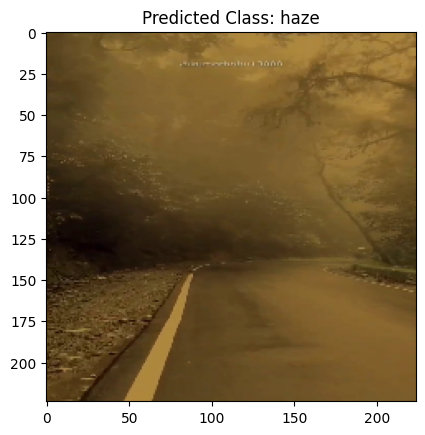

1/1 [==============================] - 0s 88ms/step


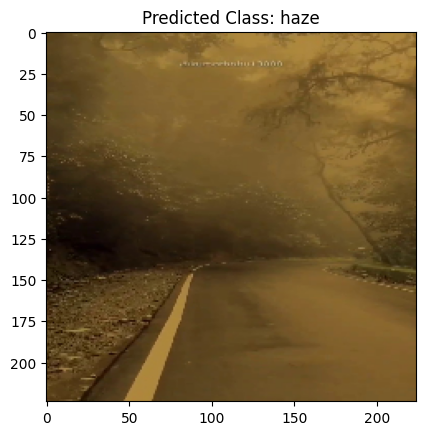

1/1 [==============================] - 0s 84ms/step


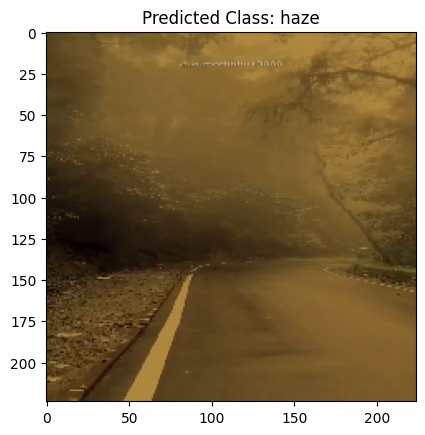

1/1 [==============================] - 0s 96ms/step


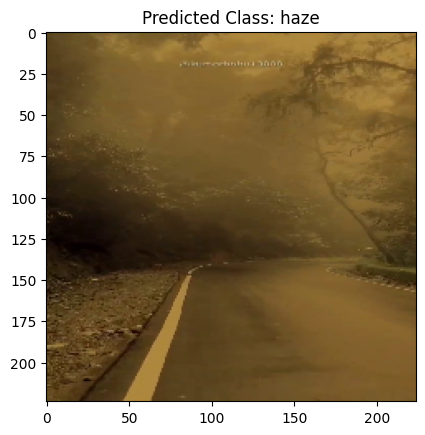

1/1 [==============================] - 0s 88ms/step


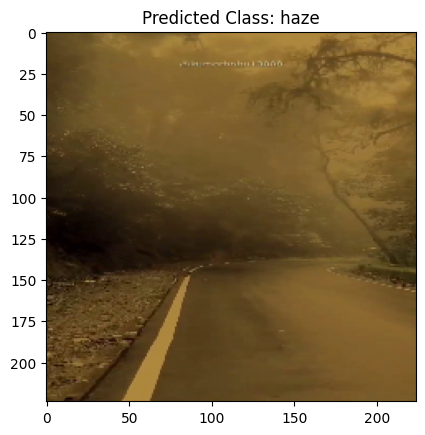

1/1 [==============================] - 0s 84ms/step


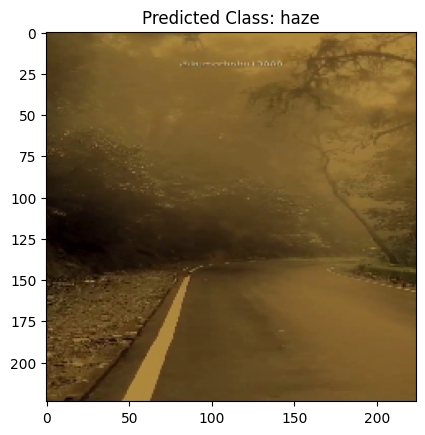

1/1 [==============================] - 0s 93ms/step


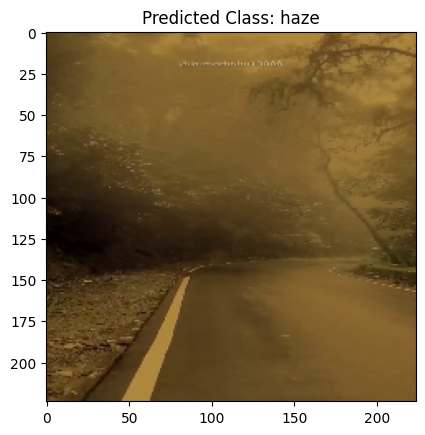

1/1 [==============================] - 0s 83ms/step


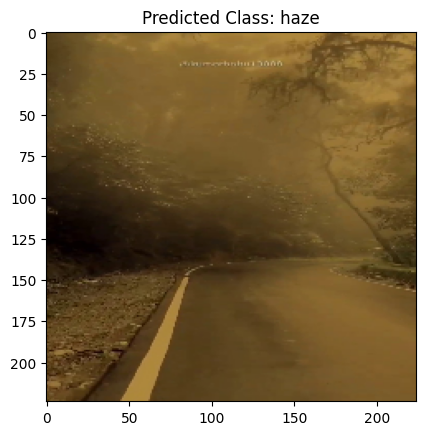

1/1 [==============================] - 0s 88ms/step


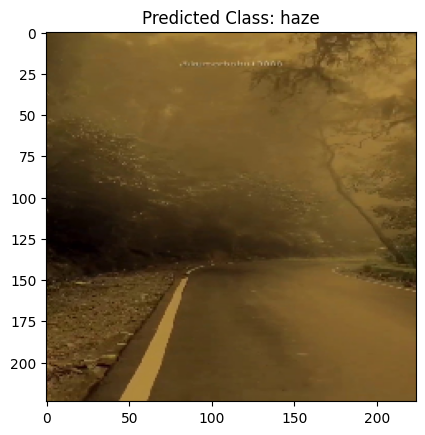

1/1 [==============================] - 0s 96ms/step


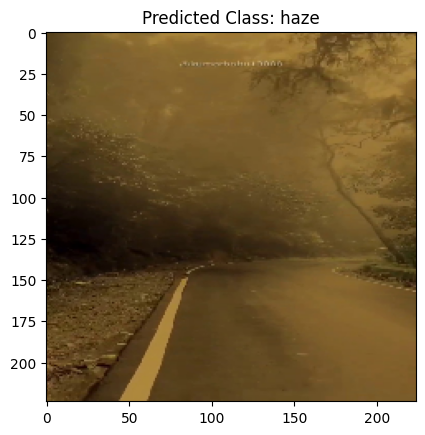

1/1 [==============================] - 0s 80ms/step


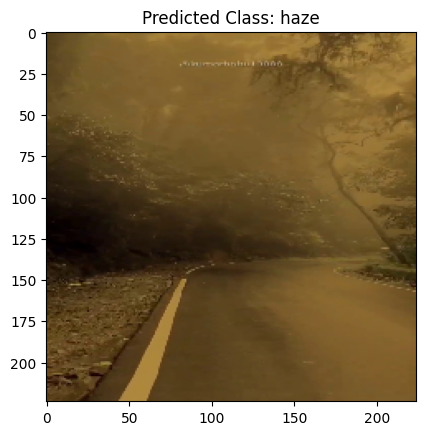

1/1 [==============================] - 0s 99ms/step


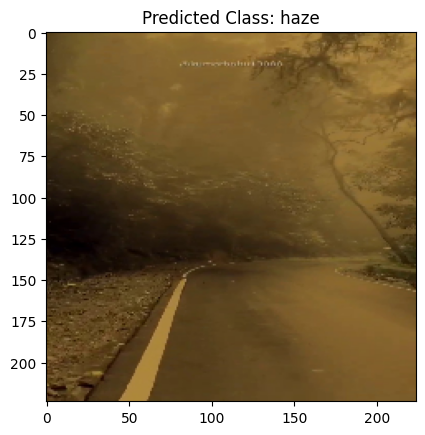

1/1 [==============================] - 0s 80ms/step


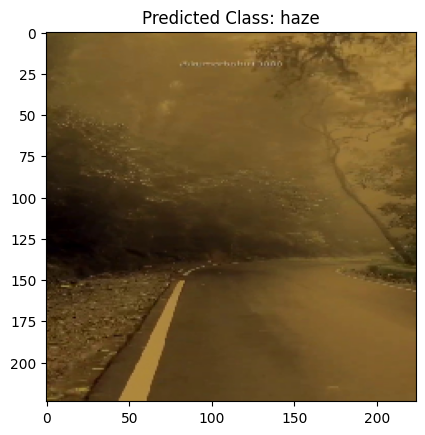

1/1 [==============================] - 0s 91ms/step


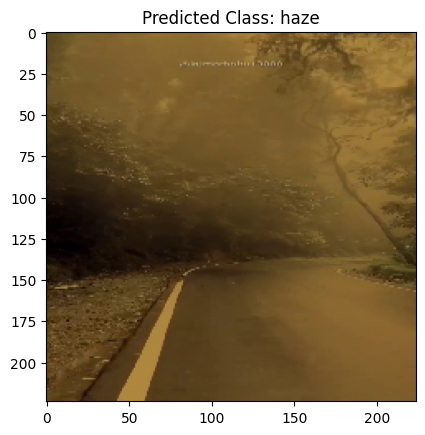

1/1 [==============================] - 0s 92ms/step


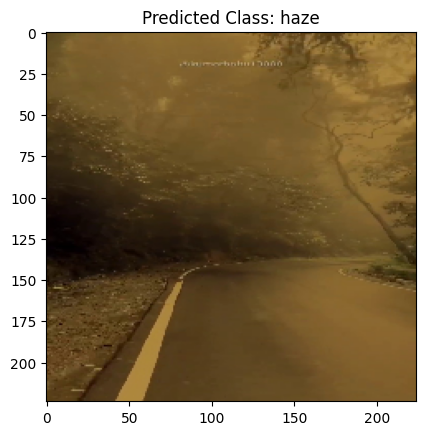

1/1 [==============================] - 0s 93ms/step


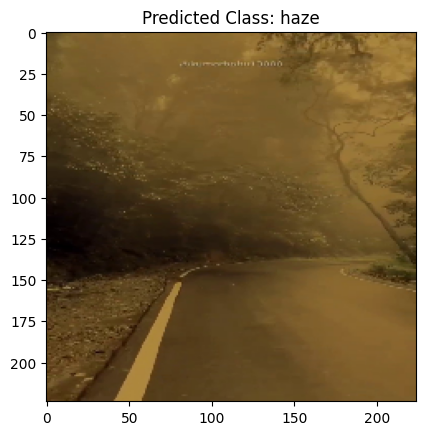

1/1 [==============================] - 0s 81ms/step


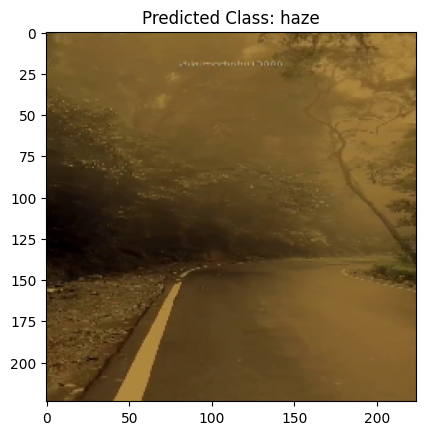

1/1 [==============================] - 0s 103ms/step


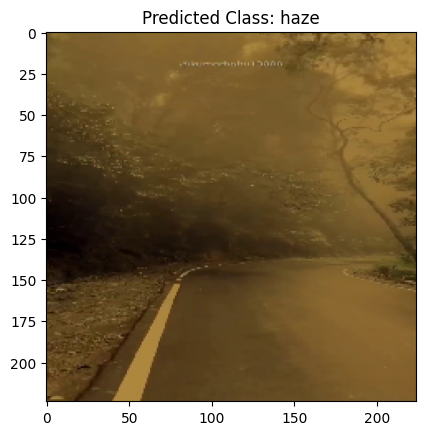

1/1 [==============================] - 0s 72ms/step


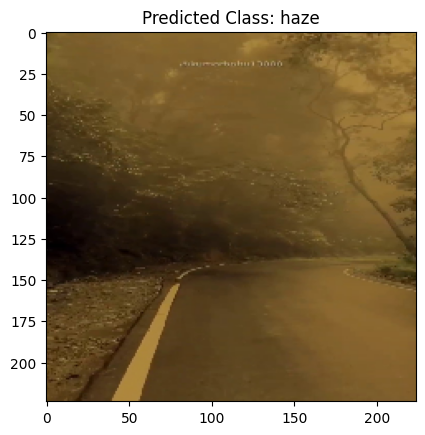

1/1 [==============================] - 0s 96ms/step


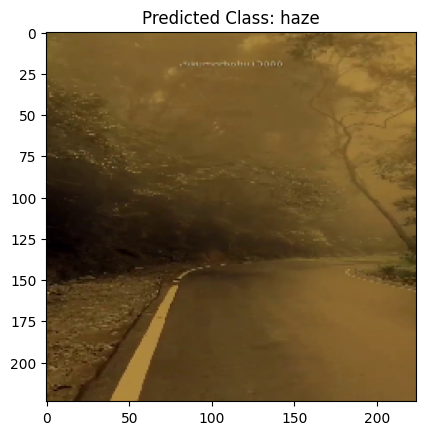

1/1 [==============================] - 0s 76ms/step


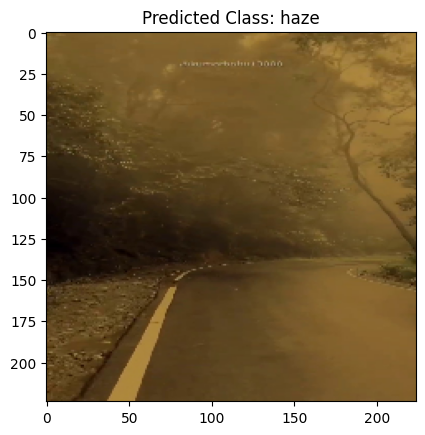

1/1 [==============================] - 0s 88ms/step


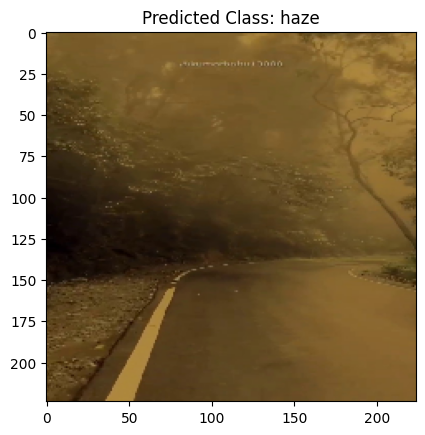

1/1 [==============================] - 0s 98ms/step


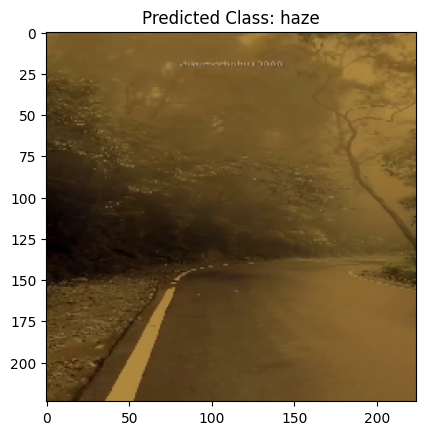

1/1 [==============================] - 0s 79ms/step


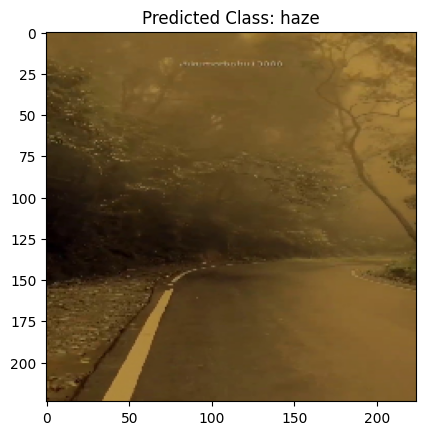

1/1 [==============================] - 0s 83ms/step


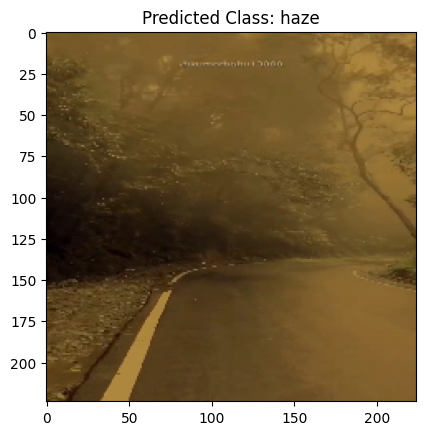

1/1 [==============================] - 0s 99ms/step


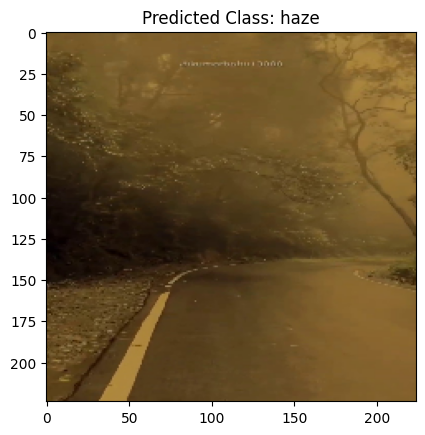

1/1 [==============================] - 0s 83ms/step


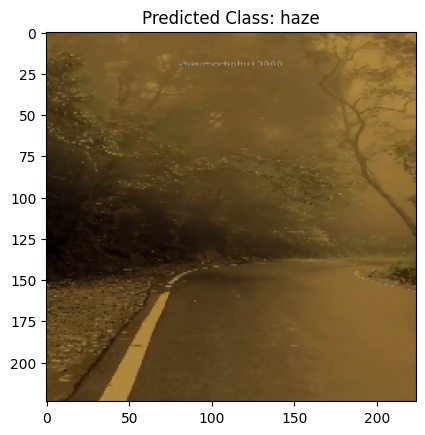

1/1 [==============================] - 0s 90ms/step


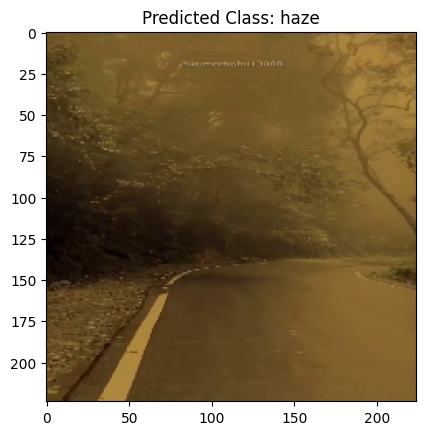

1/1 [==============================] - 0s 82ms/step


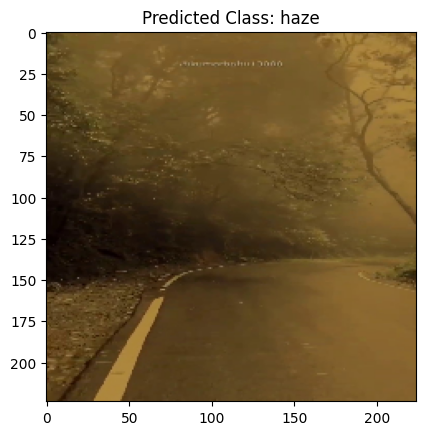

1/1 [==============================] - 0s 96ms/step


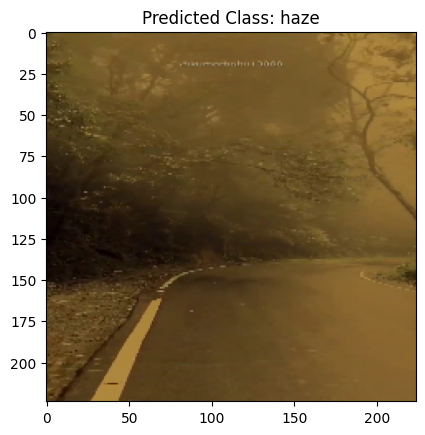

1/1 [==============================] - 0s 82ms/step


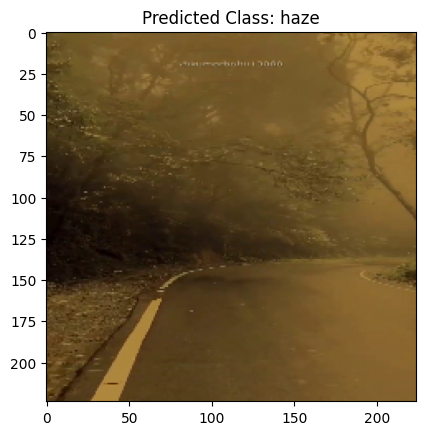

1/1 [==============================] - 0s 82ms/step


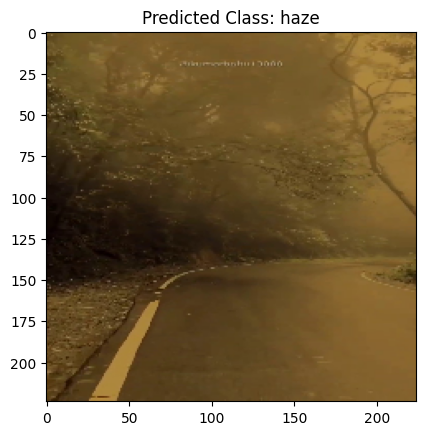

1/1 [==============================] - 0s 88ms/step


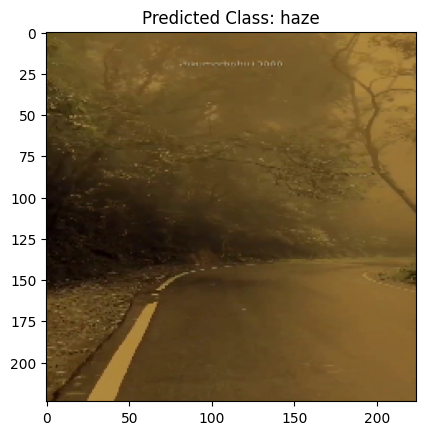

1/1 [==============================] - 0s 89ms/step


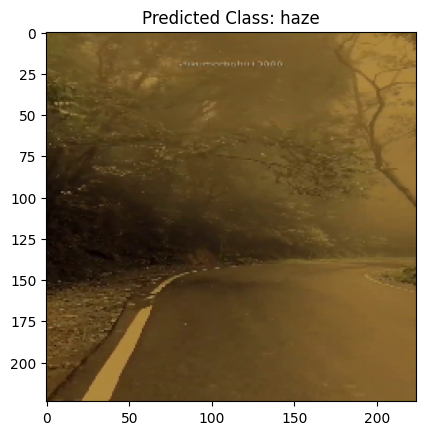

1/1 [==============================] - 0s 96ms/step


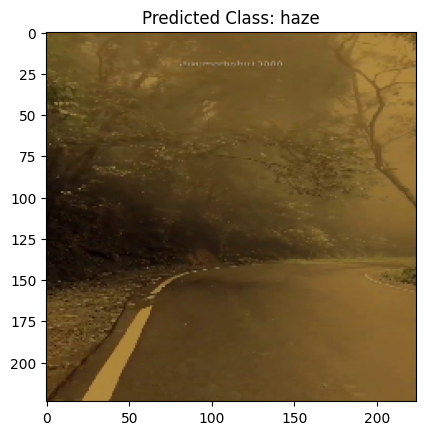

1/1 [==============================] - 0s 72ms/step


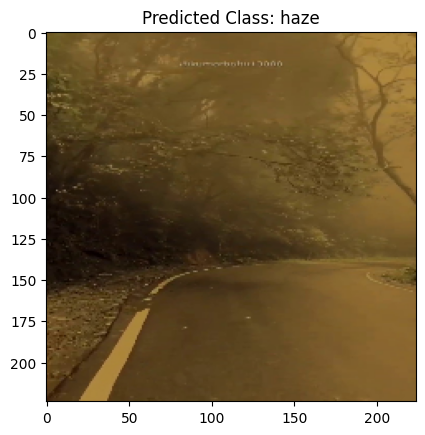

1/1 [==============================] - 0s 80ms/step


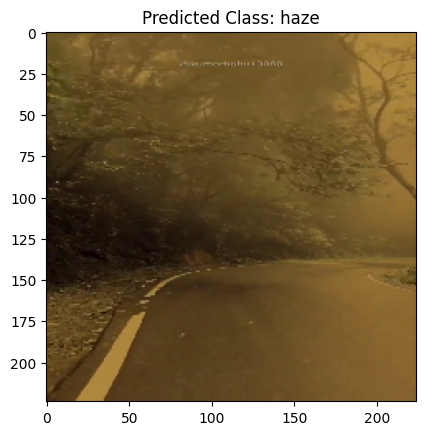

1/1 [==============================] - 0s 96ms/step


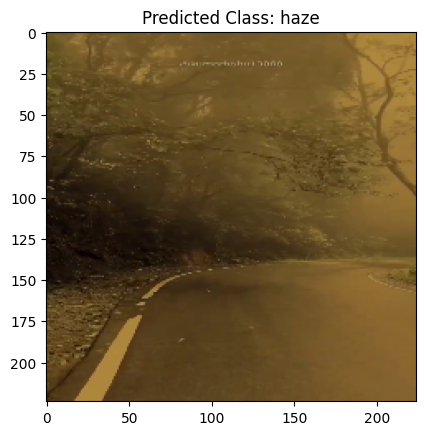

1/1 [==============================] - 0s 88ms/step


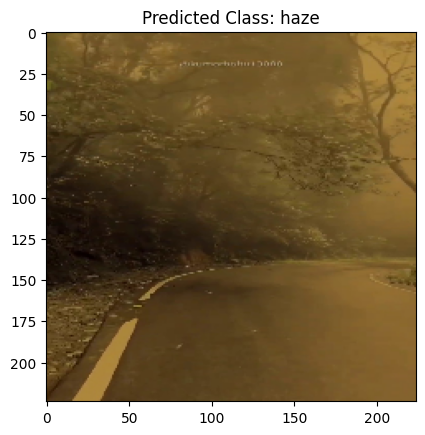

1/1 [==============================] - 0s 88ms/step


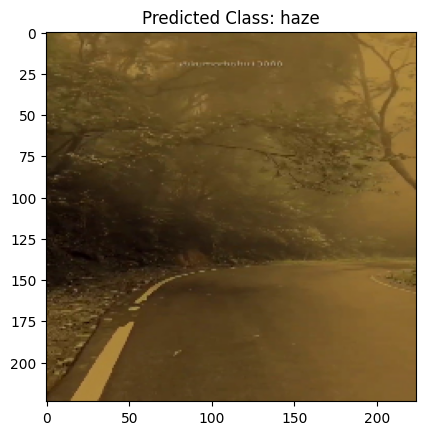

1/1 [==============================] - 0s 91ms/step


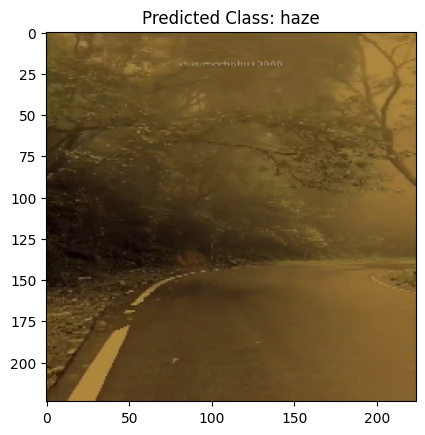

1/1 [==============================] - 0s 96ms/step


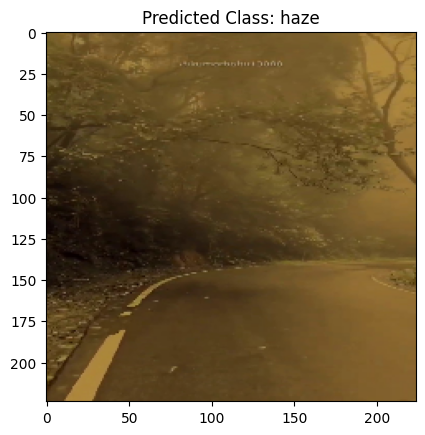

1/1 [==============================] - 0s 88ms/step


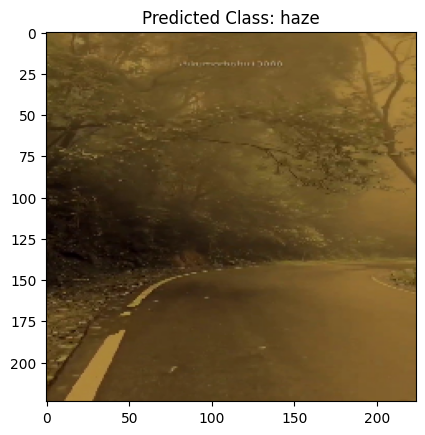

1/1 [==============================] - 0s 83ms/step


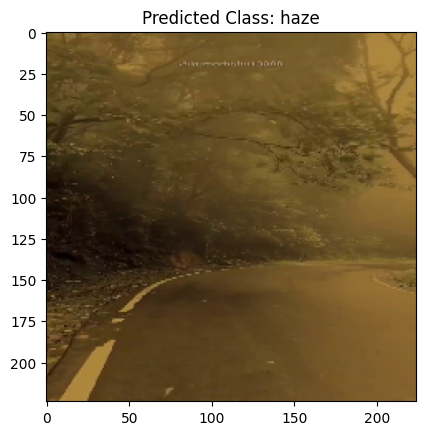

1/1 [==============================] - 0s 88ms/step


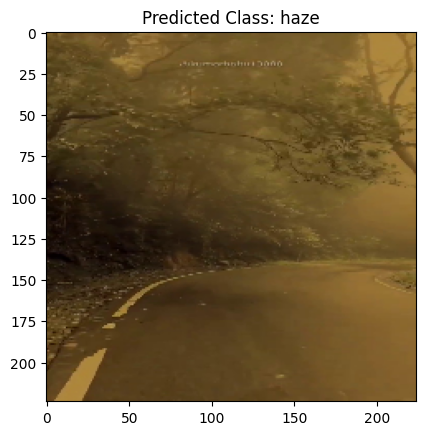

1/1 [==============================] - 0s 96ms/step


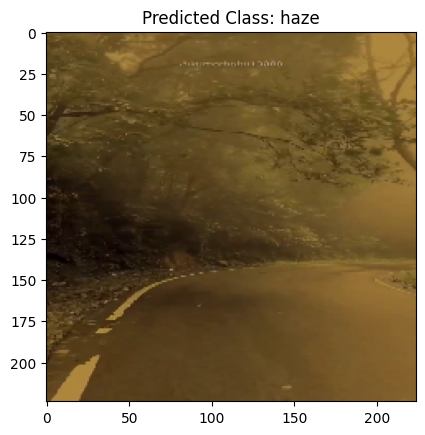

1/1 [==============================] - 0s 90ms/step


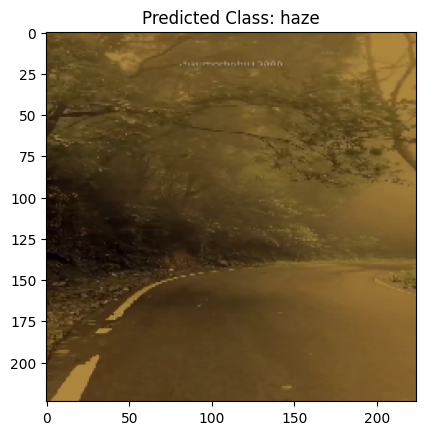

1/1 [==============================] - 0s 102ms/step


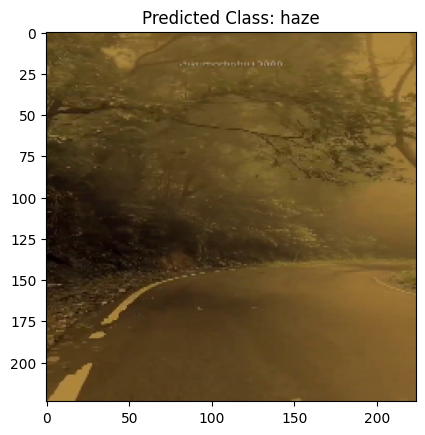

1/1 [==============================] - 0s 92ms/step


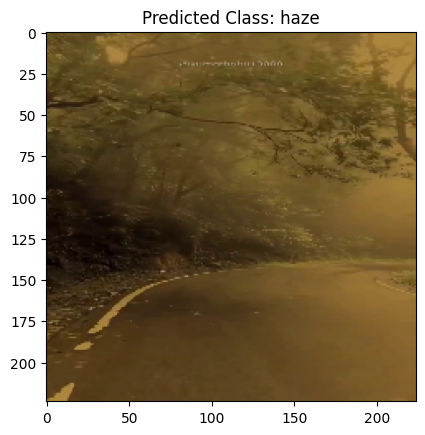

1/1 [==============================] - 0s 94ms/step


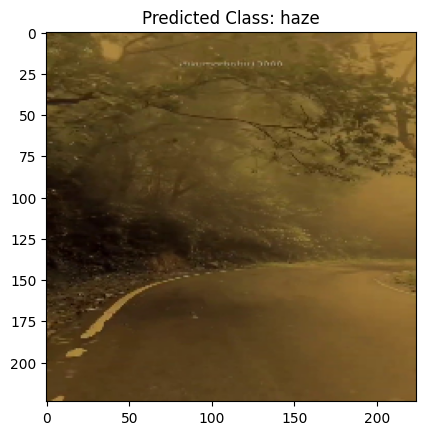

1/1 [==============================] - 0s 96ms/step


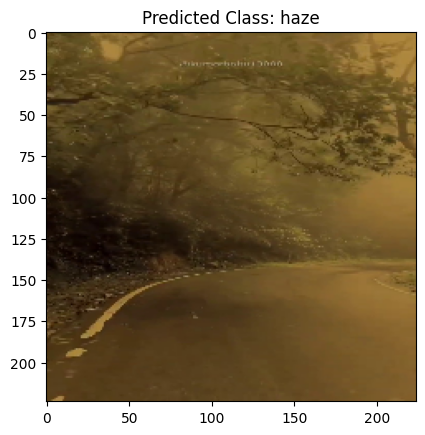

1/1 [==============================] - 0s 88ms/step


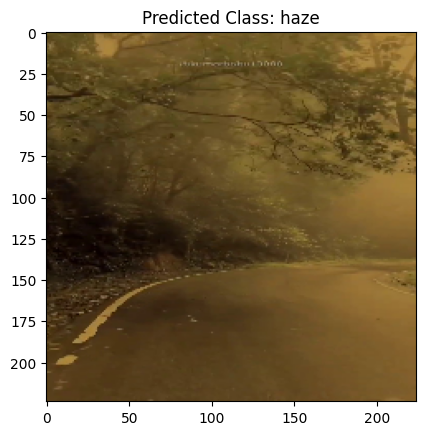

1/1 [==============================] - 0s 97ms/step


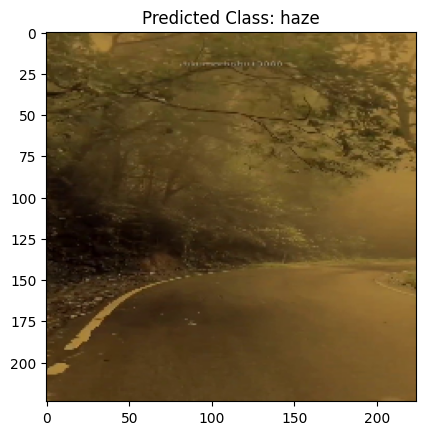

1/1 [==============================] - 0s 85ms/step


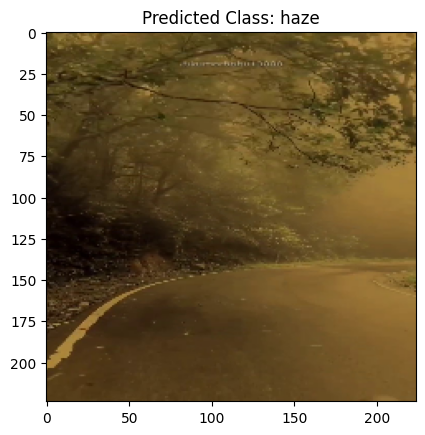

1/1 [==============================] - 0s 80ms/step


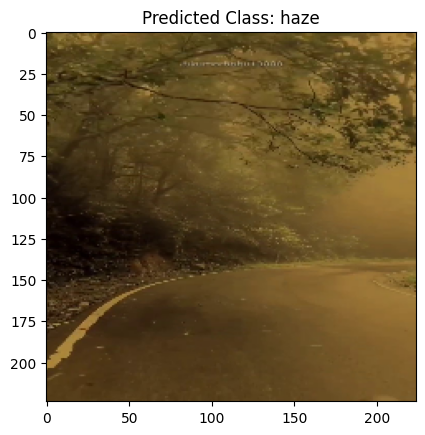

1/1 [==============================] - 0s 104ms/step


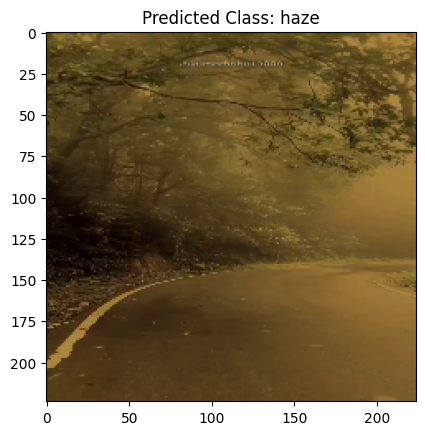

1/1 [==============================] - 0s 96ms/step


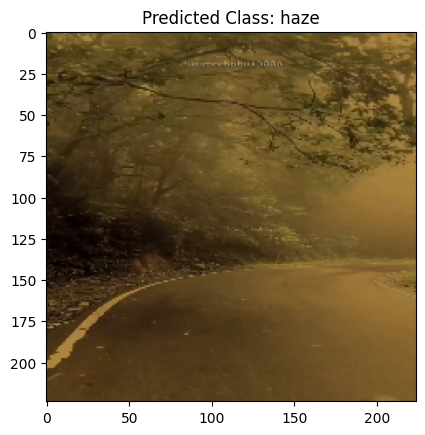

1/1 [==============================] - 0s 102ms/step


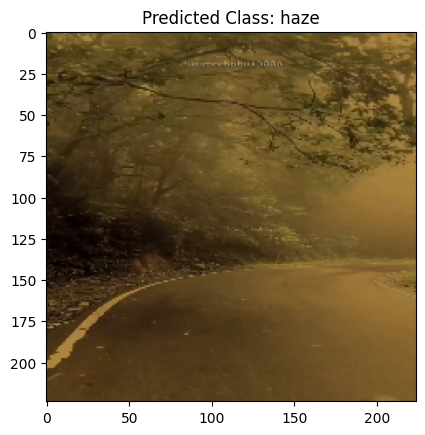

In [ ]:
# Load the model
model = keras.models.load_model("fog_haze.h5")

# Define the target size for image resizing
target_size = (224, 224)

# Specify the folder containing images
folder_path = "./frames"

# List all image files in the folder
image_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Loop through the images and classify
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)

    # Load and preprocess the image
    img = tf.keras.preprocessing.image.load_img(image_path, target_size=target_size)
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = np.array([img_array])

    # Perform predictions using the model
    predictions = model.predict(img_array)

    # Display the results
    class_labels = ["fog", "haze"]  # Replace with your actual class labels
    predicted_class = np.argmax(predictions, axis=1)

    # Plot the image and its predicted class
    plt.imshow(img)
    plt.title(f"Predicted Class: {class_labels[predicted_class[0]]}")
    plt.show()




In [ ]:
model = tf.keras.models.load_model('fog_haze.h5')
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          